## TCC CBB

Desenvolvido por Ricardo e Thyago.

#### Objetivo: 

Aplicação das técnicas de classificação SVM e XGboost junto aos algoritmos bio-inspirados FA e PSO.

Neste script é aplicado os algoritmos de classificação SVM e XGboost também o modelo estatístico
com seu ponderamento feito pelos algoritmos Bio-inspirados.
Também é calculado a Média, tempo e desvio-padrão, bem como o Tempo de execução e a Distância euclidiana 
entre a posição dos melhores agentes para o FA.

Fez-se a analise dos parâmetros de aplicação do XGBoost e a técnica foi reaplicada com os paramêtros atualizados.

### Import de bibliotecas

In [ ]:
import random
import bigml.api
import os
import pandas as pd
from bigml.api import BigML
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
import plotly.express as px
import cufflinks as cf

In [11]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
plt.rcParams['animation.ffmpeg_path'] = 'C:\\Users\\Ricardo\\Desktop\\ffmpeg-20200206-343ccfc-win64-static\\bin\\ffmpeg.exe'

### Import das bibliotecas do XGBoost

In [12]:
import xgboost as xgb
from xgboost import XGBClassifier

In [13]:
api = BigML('ricardomorellosantos','b34ec3c18161b1da38b0c5e04520224f7544405e')

In [14]:
api.download_dataset(dataset='dataset/5e356cd41efc9271bf006ea2', filename=os.getcwd()+'\\bigml.csv')

'C:\\Users\\Ricardo\\Downloads\\bigml.csv'

### Funções de tratamento da base de dados Churn in Telecom's data set

In [15]:
def converte_binario(palavra):
    if palavra=='Yes' or palavra==True:
        return 0
    elif palavra=='No' or palavra==False:
        return 1

In [16]:
def descarregaBaseDados():
    df_bigml = pd.read_csv(os.getcwd()+'\\bigml.csv')
    states = df_bigml['State'].value_counts()
    df_bigml['Voice mail plan'] = df_bigml['Voice mail plan'].apply(converte_binario)
    df_bigml['International plan'] = df_bigml['International plan'].apply(converte_binario)
    df_bigml['Churn'] = df_bigml['Churn'].apply(converte_binario)
    df_bigml_target = df_bigml['Churn']
    df_bigml.drop('Churn', axis=1, inplace=True)
    df_bigml_target.head()
    print(df_bigml_target.value_counts())
    array_estados = []
    i = 0
    for index, val in states.iteritems():
        array_estados.append(index)    
        i = 0
    for estado in array_estados:
        df_bigml['State'] = df_bigml['State'].replace(to_replace=estado, value=i)
        i = i+1
    return df_bigml, df_bigml_target

### Funções para Kfold, XGBoost e SVM

In [17]:
def aplicaKFold(x_pca, df_bigml_target):
    divisao = 0.2
    X_train, X_test, y_train, y_test = train_test_split(x_pca, df_bigml_target, test_size=divisao, random_state = 42)
    return (X_train, X_test, y_train, y_test)

In [18]:
def aplicaSVM(X_train, X_test, y_train): 
    modelSVM = SVC(probability=True, kernel = 'rbf')
    modelSVM.fit(X_train, y_train)
    predictionsSVM = modelSVM.predict_proba(X_test)

    return predictionsSVM

In [19]:
def aplicaXGBoost(X_train, X_test, y_train):
    xg_reg = xgb.XGBClassifier(objective ='binary:logistic', colsample_bytree = 0.3, learning_rate = 1,
                max_depth = 10, alpha = 10, n_estimators = 10)
    xg_reg.fit(X_train,y_train)
    predictionsXGBoost = xg_reg.predict_proba(X_test)
    return predictionsXGBoost

In [3]:
###

In [20]:
class sw(object):

    def __init__(self):

        self.__Positions = []
        self.__Gbest = []

    def _set_Gbest(self, Gbest):
        self.__Gbest = Gbest

    def _points(self, agents):
        self.__Positions.append([list(i) for i in agents])

    def get_agents(self):
        """Returns a history of all agents of the algorithm (return type:
        list)"""

        return self.__Positions

    def get_Gbest(self):
        """Return the best position of algorithm (return type: list)"""

        return list(self.__Gbest)

In [21]:
%matplotlib inline

In [23]:
from matplotlib import pyplot as plt
import matplotlib.animation
from matplotlib.ticker import LinearLocator, FormatStrFormatter
from mpl_toolkits.mplot3d import Axes3D
import numpy as np
import pandas as pd
import matplotlib.animation as animation

def animationFA(agents, function, lb, ub,y_test, sr=False):

    side = np.linspace(lb, ub, (ub - lb) * 5)
    X, Y = np.meshgrid(side, side)
    Z = np.array([np.array([function([X[i][j], Y[i][j]], y_test)
                            for j in range(len(X))])
                  for i in range(len(X[0]))])

    fig, ax = plt.subplots(1, 1, figsize=(12,6))
    ax.set_xlabel('SVM')
    ax.set_ylabel('XGBoost')
    plt.axes(xlim=(lb, ub), ylim=(lb, ub))
    plt.pcolormesh(X, Y, Z, shading='flat')
    plt.colorbar()
    x = np.array([j[0] for j in agents[0]])
    y = np.array([j[1] for j in agents[0]])
    sc = plt.scatter(x, y, color='black')

    plt.title(function.__name__, loc='left')
    plt
    def an(i):
        x = np.array([j[0] for j in agents[i]])
        y = np.array([j[1] for j in agents[i]])
        sc.set_offsets(list(zip(x, y)))
        plt.title('iteration: {}'.format(i), loc='right')
    
    Writer = animation.writers['ffmpeg']
    writer = Writer(fps=15, metadata=dict(artist='Me'), bitrate=1800)
    ani = matplotlib.animation.FuncAnimation(fig, an, frames=len(agents) - 1)

    if sr:
        ani.save('im.mp4', writer=writer)

    plt.show()


def animation3D(agents, function, lb, ub, y_test, sr=False):

    side = np.linspace(lb, ub, 45)
    X, Y = np.meshgrid(side, side)
    zs = np.array([function([x, y], y_test) for x, y in zip(np.ravel(X), np.ravel(Y))])
    Z = zs.reshape(X.shape)

    fig = plt.figure()

    ax = Axes3D(fig)
    surf = ax.plot_surface(X, Y, Z, rstride=1, cstride=1, cmap='jet',
                           linewidth=0, antialiased=False)
    ax.set_xlim(lb, ub)
    ax.set_ylim(lb, ub)

    ax.zaxis.set_major_locator(LinearLocator(10))
    ax.zaxis.set_major_formatter(FormatStrFormatter('%.02f'))

    fig.colorbar(surf, shrink=0.5, aspect=5)

    iter = len(agents)
    n = len(agents[0])
    t = np.array([np.ones(n) * i for i in range(iter)]).flatten()
    b = []
    [[b.append(agent) for agent in epoch] for epoch in agents]
    c = [function(x, y_test) for x in b]
    a = np.asarray(b)
    df = pd.DataFrame({"time": t, "x": a[:, 0], "y": a[:, 1], "z": c})

    def update_graph(num):
        data = df[df['time'] == num]
        graph._offsets3d = (data.x, data.y, data.z)
        title.set_text(function.__name__ + " " * 45 + 'iteration: {}'.format(
            num))

    title = ax.set_title(function.__name__ + " " * 45 + 'iteration: 0')

    data = df[df['time'] == 0]
    graph = ax.scatter(data.x, data.y, data.z, color='black')

    ani = matplotlib.animation.FuncAnimation(fig, update_graph, iter,
                                             interval=50, blit=False)

    if sr:

        ani.save('result.mp4')

    plt.show()

In [24]:
def trunca_agentes(array):
    for line in array:
        if line[0] + line[1] > 1:
            line[0] = line[0]/2
            line[1] = line[1]/2 
    return array;

### Classe para o algoritmo Firefly FA

In [25]:
from math import exp
import numpy as np

class fa(sw):
    """
    Firefly Algorithm
    """
    def __init__(self, n, function, lb, ub, dimension, iteration, y_test, vetor_pbest, vetor_acertos, csi=1, psi=1,
                 alpha0=10, alpha1=0.5, norm0=0, norm1=0.1):
        """
        :param n: number of agents
        :param function: test function
        :param lb: lower limits for plot axes
        :param ub: upper limits for plot axes
        :param dimension: space dimension
        :param iteration: number of iterations
        :param csi: mutual attraction (default value is 1)
        :param psi: light absorption coefficient of the medium
        (default value is 1)
        :param alpha0: initial value of the free randomization parameter alpha
        (default value is 1)
        :param alpha1: final value of the free randomization parameter alpha
        (default value is 0.1)
        :param norm0: first parameter for a normal (Gaussian) distribution
        (default value is 0)
        :param norm1: second parameter for a normal (Gaussian) distribution
        (default value is 0.1)
        """

        super(fa, self).__init__()

        self.__agents = trunca_agentes(np.random.uniform(lb, ub, (n, dimension)))
        self._points(self.__agents)
        Pbest = self.__agents[np.array([function(x, y_test)
                                        for x in self.__agents]).argmax()]
        Gbest = Pbest
        vetor_pbest.append(Pbest)
        vetor_acertos.append(function(Pbest, y_test))
        for t in range(iteration):
            alpha = alpha1 + (alpha0 - alpha1) * exp(-t)
            for i in range(n):
                fitness = [function(x, y_test) for x in self.__agents]
                for j in range(n):
                    if fitness[i] < fitness[j]:
                        self.__move(i, j, t, csi, psi, alpha, dimension,
                                    norm0, norm1)
                    else:
                        self.__agents[i] += np.random.normal(norm0, norm1,
                                                             dimension)

            self.__agents = trunca_agentes(np.clip(self.__agents, lb, ub))
            self._points(self.__agents)
            
            Pbest = self.__agents[
                np.array([function(x, y_test) for x in self.__agents]).argmax()]
            if function(Pbest, y_test) > function(Gbest, y_test):
                Gbest = Pbest
            vetor_pbest.append(Gbest)
            vetor_acertos.append(function(Gbest, y_test))
        self._set_Gbest(Gbest)

    def __move(self, i, j, t, csi, psi, alpha, dimension, norm0, norm1):
        r = np.linalg.norm(self.__agents[i] - self.__agents[j])
        beta = csi / (1 + psi * r ** 2)
        self.__agents[i] = self.__agents[j] + beta * (
            self.__agents[i] - self.__agents[j]) + alpha * exp(-t) * \
                                                   np.random.normal(norm0,
                                                                    norm1,
                                                                    dimension)

### Função para a verificaçao de acertos do modelo estatístico

In [26]:
def verifica_acertos(predicoes, y_test):
    qtd_acertos = []
    for i in range(predicoes.shape[0]):
        if predicoes[i] == y_test[i]:
            qtd_acertos.append(1)
        else:
            qtd_acertos.append(0)
    return np.asarray(qtd_acertos)

In [27]:
def retorna_acertos(x, y_test):
    svm_alpha = ( ( 1 - predictionsSVM[:,1] ) ** x[0] )
    xgboost_beta =  ( ( 1 - predictionsXGBoost[:,1] ) ** x[1] )
    predicoes = 1 - (svm_alpha*xgboost_beta)
    qtd_acertos = np.subtract(y_test,np.round(predicoes))
    return np.count_nonzero(qtd_acertos == 0)

### Aplicação do XGBoost e SVM junto ao algoritmo Firefly FA

In [28]:
import SwarmPackagePy
import matplotlib.pyplot as plt
from SwarmPackagePy import testFunctions as tf

df_bigml, df_bigml_target = descarregaBaseDados()
scaler = StandardScaler()

scaler.fit(df_bigml)

scaled_data = scaler.transform(df_bigml)  
pca_svm = PCA(n_components = 16)
pca_svm.fit(scaled_data)
x_pca_svm = pca_svm.transform(scaled_data)

pca_xgboost = PCA(n_components=17)
pca_xgboost.fit(scaled_data)
x_pca_xgboost = pca_xgboost.transform(scaled_data)

X_train_svm, X_test_svm, y_train_svm, y_test_svm = aplicaKFold(x_pca_svm, df_bigml_target)
X_train_xgboost, X_test_xgboost, y_train_xgboost, y_test_xgboost = aplicaKFold(x_pca_xgboost, df_bigml_target)

predictionsSVM = aplicaSVM(X_train_svm, X_test_svm, y_train_svm)
predictionsXGBoost = aplicaXGBoost(X_train_xgboost, X_test_xgboost, y_train_xgboost)

vetor_pbest = []
vetor_acertos = []

alh = fa(40, retorna_acertos, 0, 1, 2, 50, y_test_svm, vetor_pbest, vetor_acertos)
arr = np.array(alh.get_agents())
animationFA(alh.get_agents(), retorna_acertos, 0, 1, y_test_svm, sr=True)
animation3D(alh.get_agents(), retorna_acertos, 0, 1, y_test_svm, sr=True)
print(alh.get_Gbest())

1    2850
0     483
Name: Churn, dtype: int64


KeyboardInterrupt: 

### APlicação do Modelo Estatístico com o ponderamento dos melhores agentes encontrados na sa´da do algoritmos FA

In [30]:
svm_alpha = ( ( 1 - predictionsSVM[:,1] ) ** alh.get_Gbest()[0] )
xgboost_beta =  ( ( 1 - predictionsXGBoost[:,1] ) ** alh.get_Gbest()[1])
predicoes = 1 - (svm_alpha*xgboost_beta)
qtd_acertos = np.subtract(y_test_svm,np.round(predicoes))
np.count_nonzero(qtd_acertos == 0)/len(y_test_svm) * 100

93.4032983508246

### Curva ROC

In [35]:
from sklearn.metrics import roc_curve
from sklearn.metrics import auc
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
fpr, tpr, thresholds = roc_curve(y_test_svm, predicoes)
roc_auc = auc(fpr, tpr)
print(roc_auc)
fig = plt.figure(figsize=(12,6))
plt.xlabel('1-Especificidade')
plt.ylabel('Sensibilidade')
plt.plot([0, 1], [0, 1], color='red', linestyle='--')
plt.title('Curva ROC Modelo estatístico')
plt.plot(fpr, tpr, color='blue', lw=2, label='ROC area = %0.2f)' % roc_auc)
plt.legend(loc="lower right")
plt.show()
fig.savefig('ROC_Modelo_Estatistico_BIGML_SVM.PNG')

NameError: name 'predicoes' is not defined

In [ ]:
vetor_acertos
assertividade = [(x / 667) * 100 for x in vetor_acertos]

In [ ]:
df_acertos = pd.DataFrame(assertividade)

In [20]:
fig = plt.figure(figsize=(12,8))
plt.rcParams.update({'font.size': 20})
sns.lineplot(data=df_acertos)
plt.legend('')
plt.title('Porcentagem de acertos FA')
plt.xlabel('Iteração')
plt.ylabel('Porcentagem')
plt.savefig('bigml_fa_porcentagem_acertos.png')
plt.show()


NameError: name 'sns' is not defined

<Figure size 864x576 with 0 Axes>

In [154]:
df_pbest = pd.DataFrame(vetor_pbest, columns = ['x', 'y'])
df_pbest['iteracao'] = np.arange(0, 51)

# Média, tempo e desvio-padrão FA

In [32]:
from time import perf_counter 
  

In [22]:
import SwarmPackagePy
import matplotlib.pyplot as plt
from SwarmPackagePy import testFunctions as tf


df_bigml, df_bigml_target = descarregaBaseDados()
scaler = StandardScaler()

scaler.fit(df_bigml)

tempo = []
melhor = []

for i in range(50):
    print(i)
    t1_start = perf_counter()  
    scaled_data = scaler.transform(df_bigml)  
    pca_svm = PCA(n_components = 16)
    pca_svm.fit(scaled_data)
    x_pca_svm = pca_svm.transform(scaled_data)

    pca_xgboost = PCA(n_components=17)
    pca_xgboost.fit(scaled_data)
    x_pca_xgboost = pca_xgboost.transform(scaled_data)

    X_train_svm, X_test_svm, y_train_svm, y_test_svm = aplicaKFold(x_pca_svm, df_bigml_target)
    X_train_xgboost, X_test_xgboost, y_train_xgboost, y_test_xgboost = aplicaKFold(x_pca_xgboost, df_bigml_target)

    predictionsSVM = aplicaSVM(X_train_svm, X_test_svm, y_train_svm)
    predictionsXGBoost = aplicaXGBoost(X_train_xgboost, X_test_xgboost, y_train_xgboost)

    vetor_pbest = []
    vetor_acertos = []

    alh = fa(40, retorna_acertos, 0, 1, 2, 50, y_test_svm, vetor_pbest, vetor_acertos)
    arr = np.array(alh.get_agents())
    t1_stop = perf_counter() 
    melhor.append(alh.get_Gbest())
    tempo.append(t1_stop-t1_start)
    #animationFA(alh.get_agents(), retorna_acertos, 0, 1, y_test_svm, sr=True)
    #animation3D(alh.get_agents(), retorna_acertos, 0, 1, y_test_svm, sr=True)
    print(alh.get_Gbest())

1    2850
0     483
Name: Churn, dtype: int64
0


NameError: name 'PCA' is not defined

In [134]:
df_media_desvpad_fa = pd.DataFrame()
df_media_desvpad_fa['tempo'] = tempo

In [135]:
df_media_desvpad_fa['solucoes'] = melhor

In [136]:
auc_fa = []
for solucao in melhor:
    svm_alpha = ( ( 1 - predictionsSVM[:,1] ) ** solucao[0] )
    xgboost_beta =  ( ( 1 - predictionsXGBoost[:,1] ) ** solucao[1])
    predicoes = 1 - (svm_alpha*xgboost_beta)
    qtd_acertos = np.subtract(y_test_svm,np.round(predicoes))
    np.count_nonzero(qtd_acertos == 0)/len(y_test_svm) * 100
    fpr, tpr, thresholds = roc_curve(y_test_svm, predicoes)
    auc_fa.append(auc(fpr, tpr))

In [137]:
df_media_desvpad_fa['aucs'] = auc_fa

In [155]:
df_media_desvpad_fa

,tempo,solucoes,aucs,solucao_x,solucao_y
0,27.638823,"[0.7617918794401106, 0.05808745601500068]",0.932652,0.761792,0.058087
1,32.905015,"[0.8677852596271475, 0.05143814812122499]",0.932705,0.867785,0.051438
2,25.777481,"[0.8453662012830504, 0.01331373901879471]",0.934017,0.845366,0.013314
3,32.116926,"[1.0, 0.0]",0.933964,1.000000,0.000000
4,29.525449,"[0.7933109459506051, 0.021192349555219443]",0.933964,0.793311,0.021192
5,28.997923,"[0.7972904149640244, 0.0]",0.933964,0.797290,0.000000
6,36.217399,"[0.7927834336613141, 0.0]",0.933964,0.792783,0.000000
7,32.855949,"[0.7950534439931574, 0.0]",0.933964,0.795053,0.000000
8,26.325768,"[0.8395907258794676, 0.0]",0.933964,0.839591,0.000000
9,28.528766,"[0.8233377405993856, 0.06215473774666161]",0.932652,0.823338,0.062155


In [202]:
df_media_desvpad_fa[['solucao_x','solucao_y']] = pd.DataFrame(df_media_desvpad_fa.solucoes.values.tolist(), index= df_media_desvpad_fa.index)

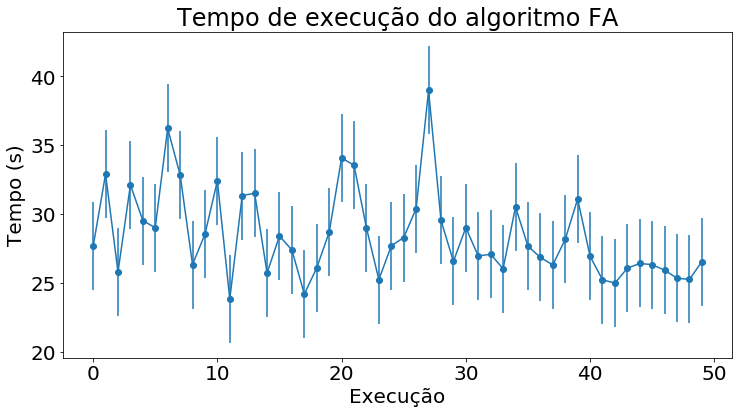

In [139]:
fig = plt.figure(figsize=(12,6))
plt.title('Tempo de execução do algoritmo FA com random_state estático')
plt.xlabel('Execução')
plt.ylabel('Tempo (s)')
df_media_desvpad_fa['tempo'].plot(yerr=df_media_desvpad_fa['tempo'].std(), marker = 'o')
plt.savefig('tempo_execucao_fa_bigml_estatico.png')



### Cálculo da distância Euclidiana entre as posições dos melhores agentes encontrados no FA

In [173]:
from scipy.spatial import distance
distancias_euclidianas = []
cont = 0
for i in df_media_desvpad_fa['solucoes']:
    if cont < len(df_media_desvpad_fa['solucoes']) - 1:
        proximo = df_media_desvpad_fa['solucoes'][cont+1]
        primeiro_ponto = (i[0], i[1])
        segundo_ponto = (proximo[0], proximo[1])
        distancias_euclidianas.append(distance.euclidean(primeiro_ponto, segundo_ponto))
        cont = cont+1
    else:
        distancias_euclidianas.append(0)

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48


In [201]:
df_media_desvpad_fa['distancias_euclidianas'] = distancias_euclidianas

0     0.106202
1     0.044228
2     0.155206
3     0.207773
4     0.021563
5     0.004507
6     0.002270
7     0.044537
8     0.064245
9     0.055090
10    0.099033
11    0.094056
12    0.020935
13    0.209127
14    0.000000
15    0.202068
16    0.008570
17    0.062268
18    0.073727
19    0.198032
20    0.301603
21    0.134496
22    0.104701
23    0.241574
24    0.175444
25    0.027635
26    0.031071
27    0.001978
28    0.087497
29    0.282259
30    0.236705
31    0.011018
32    0.062389
33    0.069845
34    0.026280
35    0.074449
36    0.029156
37    0.087931
38    0.068973
39    0.066501
40    0.120830
41    0.081467
42    0.024641
43    0.006564
44    0.039652
45    0.095861
46    0.063405
47    0.034107
48    0.226433
49    0.000000
Name: distancias_euclidianas, dtype: float64

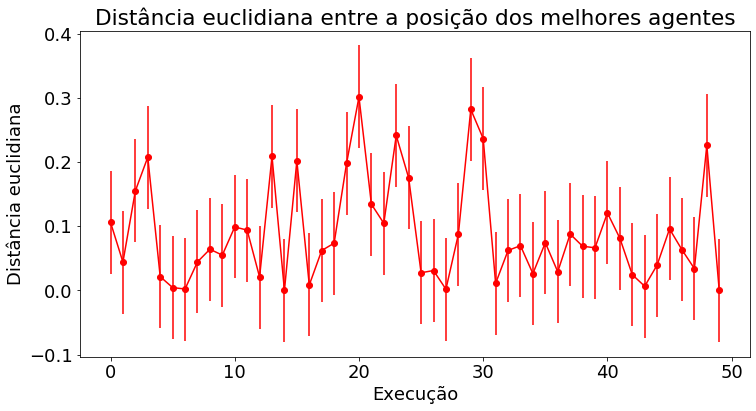

In [198]:
fig = plt.figure(figsize=(12,6))
plt.title('Distância euclidiana entre a posição dos melhores agentes com random_state estático')
plt.rcParams.update({'font.size': 18})
plt.xlabel('Execução')
plt.ylabel('Distância euclidiana')
df_media_desvpad_fa['distancias_euclidianas'].plot(yerr=df_media_desvpad_fa['distancias_euclidianas'].std(), marker = 'o', color='red')
plt.savefig('distancia_euclidiana_fa_bigml_estatico.png')



### AUCs nas iterações do algoritmo FA

0.0005824326526254843


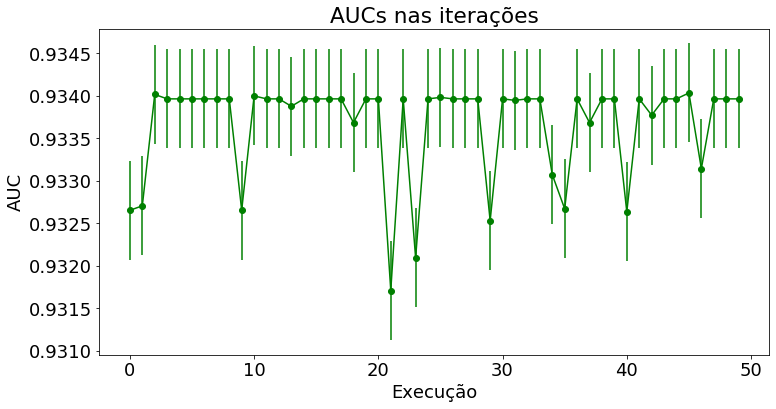

In [211]:
fig = plt.figure(figsize=(12,6))
plt.title('AUCs nas execuções com random_state estático')
plt.rcParams.update({'font.size': 18})
plt.xlabel('Execução')
plt.ylabel('AUC')
df_media_desvpad_fa['aucs'] = df_media_desvpad_fa['aucs']
print(df_media_desvpad_fa['aucs'].std())
df_media_desvpad_fa['aucs'].plot(yerr=df_media_desvpad_fa['aucs'].std(), marker = 'o', color='green')
plt.savefig('auc_fa_bigml_estatico.png')


# Média, tempo e desvio-padrão FA com diferentes amostras da base até a convergência

In [30]:
def aplicaKFoldRand(x_pca, df_bigml_target, rand):
    divisao = 0.2
    X_train, X_test, y_train, y_test = train_test_split(x_pca, df_bigml_target, test_size=divisao, random_state = rand)
    return (X_train, X_test, y_train, y_test)

In [37]:
import SwarmPackagePy
import matplotlib.pyplot as plt
from SwarmPackagePy import testFunctions as tf
from sklearn.naive_bayes import GaussianNB


gnb = GaussianNB()

df_bigml, df_bigml_target = descarregaBaseDados()
scaler = StandardScaler()

scaler.fit(df_bigml)

tempo_rand = []
melhor_rand = []
rands = []
auc_fa = []
auc_svm = []
auc_xgboost = []
convergencia = False
media_aucs = 0
auc_anterior = 0
total_iguais = 0
i = 0
while(not convergencia):
    print(i)
    rand = np.random.randint(0, 1000)
    t1_start = perf_counter()  
    scaled_data = scaler.transform(df_bigml)  
    pca_svm = PCA(n_components = 16)
    pca_svm.fit(scaled_data)
    x_pca_svm = pca_svm.transform(scaled_data)

    pca_xgboost = PCA(n_components=17)
    pca_xgboost.fit(scaled_data)
    x_pca_xgboost = pca_xgboost.transform(scaled_data)
    rands.append(rand)
    X_train_svm, X_test_svm, y_train_svm, y_test_svm = aplicaKFoldRand(x_pca_svm, df_bigml_target, rand)
    X_train_xgboost, X_test_xgboost, y_train_xgboost, y_test_xgboost = aplicaKFoldRand(x_pca_xgboost, df_bigml_target, rand)
    
    predictionsSVM = aplicaSVM(X_train_svm, X_test_svm, y_train_svm)
    predictionsXGBoost = aplicaXGBoost(X_train_xgboost, X_test_xgboost, y_train_xgboost)
    
    fprs, tprs, thresholdss = roc_curve(y_test_svm, predictionsSVM[:,1])
    fprx, tprx, thresholdsx = roc_curve(y_test_svm, predictionsXGBoost[:,1])
    
    auc_svm.append(auc(fprs, tprs))
    auc_xgboost.append(auc(fprx, tprx))
    
    vetor_pbest = []
    vetor_acertos = []

    alh = fa(40, retorna_acertos, 0, 1, 2, 50, y_test_svm, vetor_pbest, vetor_acertos)
    solucao = alh.get_Gbest()
    svm_alpha = ( ( 1 - predictionsSVM[:,1] ) ** solucao[0] )
    xgboost_beta =  ( ( 1 - predictionsXGBoost[:,1] ) ** solucao[1])
    predicoes = 1 - (svm_alpha*xgboost_beta)
    qtd_acertos = np.subtract(y_test_svm,np.round(predicoes))
    np.count_nonzero(qtd_acertos == 0)/len(y_test_svm) * 100
    fpr, tpr, thresholds = roc_curve(y_test_svm, predicoes)
    auc_fa.append(auc(fpr, tpr))
    
    media_aucs = round(sum(auc_fa)/len(auc_fa), 2)
    if media_aucs == auc_anterior:
        total_iguais = total_iguais + 1
    else:
        total_iguais = 0
    
    if total_iguais == 10:
        convergencia = True
    
    print('media_aucs:{}'.format(media_aucs))
    auc_anterior = media_aucs
    
    arr = np.array(alh.get_agents())
    t1_stop = perf_counter() 
    melhor_rand.append(alh.get_Gbest())
    tempo_rand.append(t1_stop-t1_start)
    
    print(alh.get_Gbest())

1    2850
0     483
Name: Churn, dtype: int64
0
media_aucs:0.89
[0.5047043934441272, 0.0]
0
media_aucs:0.9
[1.0449690139336378, -0.02738713076866968]
0
media_aucs:0.91
[0.627916895168944, 0.08488397532181721]
0
media_aucs:0.91
[0.6736907137549717, 0.07945031442609793]
0
media_aucs:0.91
[0.7171036779954472, 0.0]
0
media_aucs:0.9
[0.3870095603052752, 0.13488960317191812]
0
media_aucs:0.9
[0.3700845852989334, 0.131909013237209]
0
media_aucs:0.9
[0.48006028821345714, 0.07323734257792543]
0
media_aucs:0.9
[0.8646756894359606, 0.07100822188619499]
0
media_aucs:0.9
[0.7303815022427904, 0.11171321720493484]
0
media_aucs:0.9
[0.8794641277418322, 0.0]
0
media_aucs:0.9
[0.5, 0.0733915178988103]
0
media_aucs:0.9
[1.2194684785619276, -0.1411680779673138]
0
media_aucs:0.9
[0.7374752121561732, 0.0]
0
media_aucs:0.9
[0.7203203730938998, 0.028490688472661018]
0
media_aucs:0.9
[0.9113106326152551, 0.08247526840031186]


In [38]:
df_media_desvpad_fa_rand = pd.DataFrame()
df_media_desvpad_fa_rand['tempo'] = tempo_rand
df_media_desvpad_fa_rand['solucoes'] = melhor_rand
df_media_desvpad_fa_rand['rand_values'] = rands
df_media_desvpad_fa_rand['aucs'] = auc_fa
df_media_desvpad_fa_rand['auc_svm'] = auc_svm
df_media_desvpad_fa_rand['auc_xgboost'] = auc_xgboost
df_media_desvpad_fa_rand[['solucao_x','solucao_y']] = pd.DataFrame(df_media_desvpad_fa_rand.solucoes.values.tolist(), index= df_media_desvpad_fa_rand.index)

2.33217820668484


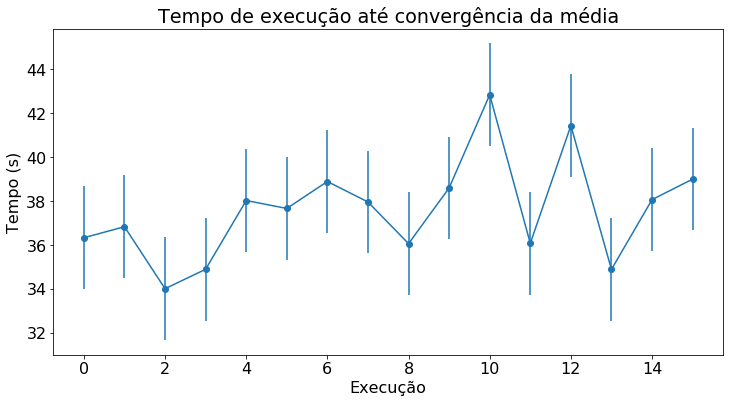

In [48]:
print(df_media_desvpad_fa_rand['tempo'].std())
fig = plt.figure(figsize=(12,6))
plt.rcParams.update({'font.size': 16})
plt.title('Tempo de execução até convergência da média')
plt.xlabel('Execução')
plt.ylabel('Tempo (s)')
df_media_desvpad_fa_rand['tempo'].plot(yerr=df_media_desvpad_fa_rand['tempo'].std(), marker = 'o')
plt.savefig('tempo_execucao_fa_bigml.png')

In [40]:
from scipy.spatial import distance
distancias_euclidianas = []
cont = 0
for i in df_media_desvpad_fa_rand['solucoes']:
    if cont < len(df_media_desvpad_fa_rand['solucoes']) - 1:
        proximo = df_media_desvpad_fa_rand['solucoes'][cont+1]
        primeiro_ponto = (i[0], i[1])
        segundo_ponto = (proximo[0], proximo[1])
        distancias_euclidianas.append(distance.euclidean(primeiro_ponto, segundo_ponto))
        cont = cont+1
    else:
        distancias_euclidianas.append(0)

In [51]:
df_media_desvpad_fa_rand['distancias_euclidianas'] = distancias_euclidianas

In [60]:
df_media_desvpad_fa_rand['distancias_euclidianas'].std()

0.2225819587430307

In [ ]:
df_media_desvpad_fa_rand['AUCs modelo estatístico'].mean()

0.2225819587430307
0     0.540958
1     0.431900
2     0.046095
3     0.090537
4     0.356591
5     0.017185
6     0.124648
7     0.384622
8     0.140328
9     0.186294
10    0.386496
11    0.750780
12    0.502241
13    0.033257
14    0.198473
15    0.000000
Name: distancias_euclidianas, dtype: float64


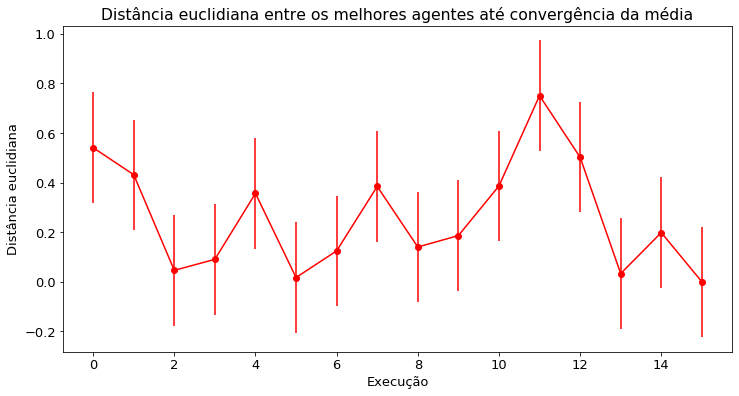

In [46]:
fig = plt.figure(figsize=(12,6))
plt.title('Distância euclidiana entre os melhores agentes até convergência da média')
plt.rcParams.update({'font.size': 13})
plt.xlabel('Execução')
plt.ylabel('Distância euclidiana')
df_media_desvpad_fa_rand['distancias_euclidianas'] = np.clip(df_media_desvpad_fa_rand['distancias_euclidianas'],0, 1)
df_media_desvpad_fa_rand['distancias_euclidianas'].plot(yerr=df_media_desvpad_fa_rand['distancias_euclidianas'].std(), marker = 'o', color='red')
plt.savefig('distancia_euclidiana_fa_bigml.png')
print(df_media_desvpad_fa_rand['distancias_euclidianas'].std())
print(df_media_desvpad_fa_rand['distancias_euclidianas'])

0.021147929483307397


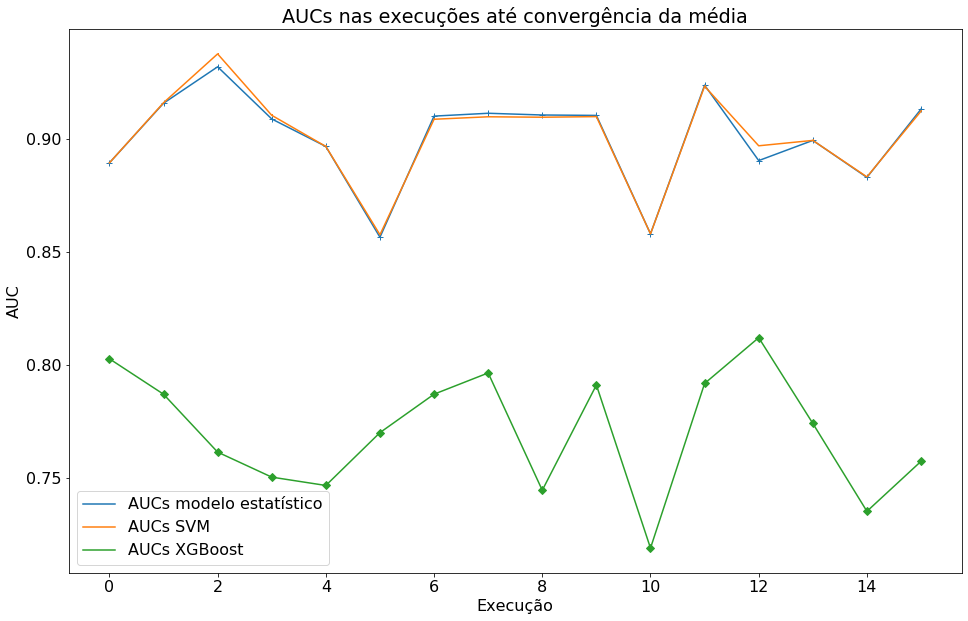

In [61]:
import matplotlib as mpl

# create valid markers from mpl.markers
valid_markers = ([item[0] for item in mpl.markers.MarkerStyle.markers.items() if
item[1] is not 'nothing' and not item[1].startswith('tick') and not item[1].startswith('caret')])
df_media_desvpad_fa_rand.rename(columns = {'aucs':'AUCs modelo estatístico', 'auc_svm':'AUCs SVM', 'auc_xgboost' : 'AUCs XGBoost'}, inplace = True) 

ax = df_media_desvpad_fa_rand[['AUCs modelo estatístico', 'AUCs SVM', 'AUCs XGBoost']].plot(figsize=(16,10))


# valid_markers = mpl.markers.MarkerStyle.filled_markers
markers = np.random.choice(valid_markers, df_media_desvpad_fa_rand.shape[1], replace=False)
for i, line in enumerate(ax.get_lines()):
    line.set_marker(markers[i])

plt.title('AUCs nas execuções até convergência da média')
plt.rcParams.update({'font.size': 18})
plt.xlabel('Execução')
plt.ylabel('AUC')


plt.savefig('auc_fa_bigml.png')

print(df_media_desvpad_fa_rand['AUCs modelo estatístico'].std())

## Aplicações do algoritmos bio-inspirado PSO

### Classe PSO

In [62]:
class swa(object):

    def __init__(self):

        self.__Positions = []
        self.__Gbest = []

    def _set_Gbest(self, __Gbest):
        self.__Gbest = __Gbest

    def _points(self, agents):
        self.__Positions.append([list(i) for i in agents])

    def get_agents(self):
        """Returns a history of all agents of the algorithm (return type:
        list)"""

        return self.__Positions

    def get_Gbest(self):
        """Return the best position of algorithm (return type: list)"""

        return list(self.__Gbest)

In [64]:
import numpy as np

class pso(swa):
    """
    Particle Swarm Optimization
    """

    def __init__(self, n, function, lb, ub, dimension, iteration, y_test_svm,vetor_pbest, vetor_acertos, w=0.5, c1=1,
                 c2=1):
        """
        :param n: number of agents
        :param function: test function
        :param lb: lower limits for plot axes
        :param ub: upper limits for plot azes
        :param dimension: space dimension
        :param iteration: the number of iterations
        :param w: balance between the range of research and consideration for
        suboptimal decisions found (default value is 0.5):
        w>1 the particle velocity increases, they fly apart and inspect
         the space more carefully;
        w<1 particle velocity decreases, convergence speed depends
        on parameters c1 and c2 ;
        :param c1: ratio between "cognitive" and "social" component
        (default value is 1)
        :param c2: ratio between "cognitive" and "social" component
        (default value is 1)
        """

        super(pso, self).__init__()

        self.__agents = trunca_agentes(np.random.uniform(lb, ub, (n, dimension)))
        velocity = np.zeros((n, dimension))
        self._points(self.__agents)

        Pbest = self.__agents[np.array([function(x, y_test_svm)
                                        for x in self.__agents]).argmax()]
        Gbest = Pbest
        vetor_pbest.append(Pbest)
        vetor_acertos.append(function(Pbest, y_test_svm))
        
        for t in range(iteration):
            r1 = np.random.random((n, dimension))
            r2 = np.random.random((n, dimension))
            velocity = w * velocity + c1 * r1 * (
                Pbest - self.__agents) + c2 * r2 * (
                Gbest - self.__agents)
            self.__agents += velocity
            self.__agents = trunca_agentes(np.clip(self.__agents, lb, ub))
            self._points(self.__agents)
         
            Pbest = self.__agents[
                np.array([function(x, y_test_svm) for x in self.__agents]).argmax()]
            if function(Pbest, y_test_svm) > function(Gbest, y_test_svm):
                Gbest = Pbest
            vetor_pbest.append(Pbest)
            vetor_acertos.append(function(Pbest, y_test_svm))
        
        self._set_Gbest(Gbest)
        print(Gbest)

## Aplicação dos algoritmos XGBoost e SVM junto ao algoritmos PSO até sua convergência 

In [67]:
import SwarmPackagePy
import matplotlib.pyplot as plt
from SwarmPackagePy import testFunctions as tf
from sklearn.naive_bayes import GaussianNB


gnb = GaussianNB()

df_bigml, df_bigml_target = descarregaBaseDados()
scaler = StandardScaler()

scaler.fit(df_bigml)

tempo_rand = []
melhor_rand = []
rands = []
auc_fa = []
auc_svm = []
auc_xgboost = []
convergencia = False
media_aucs = 0
auc_anterior = 0
total_iguais = 0
i = 0
while(not convergencia):
    print(i)
    rand = np.random.randint(0, 1000)
    t1_start = perf_counter()  
    scaled_data = scaler.transform(df_bigml)  
    pca_svm = PCA(n_components = 16)
    pca_svm.fit(scaled_data)
    x_pca_svm = pca_svm.transform(scaled_data)

    pca_xgboost = PCA(n_components=17)
    pca_xgboost.fit(scaled_data)
    x_pca_xgboost = pca_xgboost.transform(scaled_data)
    rands.append(rand)
    X_train_svm, X_test_svm, y_train_svm, y_test_svm = aplicaKFoldRand(x_pca_svm, df_bigml_target, rand)
    X_train_xgboost, X_test_xgboost, y_train_xgboost, y_test_xgboost = aplicaKFoldRand(x_pca_xgboost, df_bigml_target, rand)
    
    predictionsSVM = aplicaSVM(X_train_svm, X_test_svm, y_train_svm)
    predictionsXGBoost = aplicaXGBoost(X_train_xgboost, X_test_xgboost, y_train_xgboost)
    
    fprs, tprs, thresholdss = roc_curve(y_test_svm, predictionsSVM[:,1])
    fprx, tprx, thresholdsx = roc_curve(y_test_svm, predictionsXGBoost[:,1])
    
    auc_svm.append(auc(fprs, tprs))
    auc_xgboost.append(auc(fprx, tprx))
    
    vetor_pbest = []
    vetor_acertos = []

    alh = pso(40, retorna_acertos, 0, 1, 2, 50, y_test_svm, vetor_pbest, vetor_acertos)
    solucao = alh.get_Gbest()
    svm_alpha = ( ( 1 - predictionsSVM[:,1] ) ** solucao[0] )
    xgboost_beta =  ( ( 1 - predictionsXGBoost[:,1] ) ** solucao[1])
    predicoes = 1 - (svm_alpha*xgboost_beta)
    qtd_acertos = np.subtract(y_test_svm,np.round(predicoes))
    np.count_nonzero(qtd_acertos == 0)/len(y_test_svm) * 100
    fpr, tpr, thresholds = roc_curve(y_test_svm, predicoes)
    auc_fa.append(auc(fpr, tpr))
    
    media_aucs = round(sum(auc_fa)/len(auc_fa), 2)
    if media_aucs == auc_anterior:
        total_iguais = total_iguais + 1
    else:
        total_iguais = 0
    
    if total_iguais == 10:
        convergencia = True
    
    print('media_aucs:{}'.format(media_aucs))
    auc_anterior = media_aucs
    
    arr = np.array(alh.get_agents())
    t1_stop = perf_counter() 
    melhor_rand.append(alh.get_Gbest())
    tempo_rand.append(t1_stop-t1_start)
    
    print(alh.get_Gbest())

1    2850
0     483
Name: Churn, dtype: int64
0
[ 1.10545118 -0.05279041]
media_aucs:0.88
[1.1054511797514492, -0.05279041345276427]
0
[0.49640081 0.10211435]
media_aucs:0.91
[0.4964008063094494, 0.10211434503015131]
0
[0.7424615  0.06560327]
media_aucs:0.9
[0.7424614957963522, 0.06560327479151047]
0
[0.42657043 0.12867586]
media_aucs:0.9
[0.4265704290356883, 0.12867586323757435]
0
[0.3534889  0.11376125]
media_aucs:0.9
[0.3534888960220427, 0.11376124506526177]
0
[0.61326694 0.06645285]
media_aucs:0.9
[0.6132669365872206, 0.06645284669438647]
0
[ 0.87304164 -0.0037767 ]
media_aucs:0.91
[0.8730416425526615, -0.0037766974727486084]
0
[ 0.56512611 -0.00100911]
media_aucs:0.91
[0.565126113866149, -0.0010091090716097318]
0
[ 0.696205   -0.00107187]
media_aucs:0.91
[0.6962050007556456, -0.001071871614529236]
0
[0.85827699 0.05991309]
media_aucs:0.91
[0.8582769947594492, 0.05991308977116076]
0
[ 0.9055952  -0.00491446]
media_aucs:0.9
[0.9055951994420095, -0.0049144559104874995]
0
[0.63351748 

### Média, desvio padrão para o PSO

In [68]:
df_media_desvpad_PSO_rand = pd.DataFrame()
df_media_desvpad_PSO_rand['tempo'] = tempo_rand
df_media_desvpad_PSO_rand['solucoes'] = melhor_rand
df_media_desvpad_PSO_rand['rand_values'] = rands
df_media_desvpad_PSO_rand['aucs'] = auc_fa
df_media_desvpad_PSO_rand['auc_svm'] = auc_svm
df_media_desvpad_PSO_rand['auc_xgboost'] = auc_xgboost
df_media_desvpad_PSO_rand[['solucao_x','solucao_y']] = pd.DataFrame(df_media_desvpad_PSO_rand.solucoes.values.tolist(), index= df_media_desvpad_PSO_rand.index)

### Gráfico do tempo de execução do PSO até sua convergência

0.10034082235662967


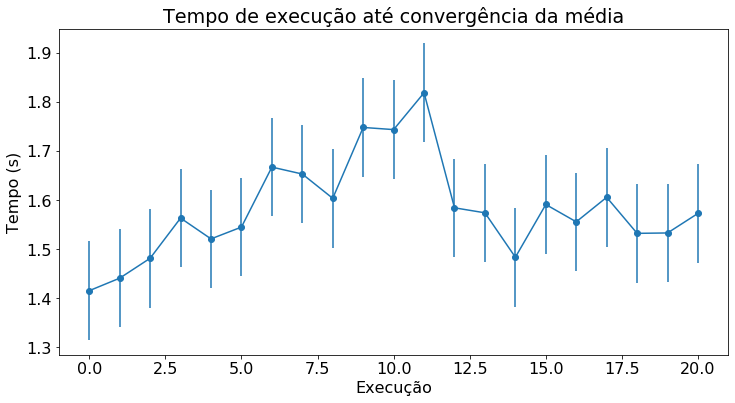

In [77]:
print(df_media_desvpad_PSO_rand['tempo'].std())
fig = plt.figure(figsize=(12,6))
plt.rcParams.update({'font.size': 16})
plt.title('Tempo de execução até convergência da média')
plt.xlabel('Execução')
plt.ylabel('Tempo (s)')
df_media_desvpad_PSO_rand['tempo'].plot(yerr=df_media_desvpad_PSO_rand['tempo'].std(), marker = 'o')
plt.savefig('tempo_execucao_pso_bigml.png')

In [81]:
df_media_desvpad_fa_rand

,tempo,solucoes,rand_values,AUCs modelo estatístico,AUCs SVM,AUCs XGBoost,solucao_x,solucao_y,distancias_euclidianas
0,1.415308,"[1.1054511797514492, -0.05279041345276427]",691,0.880062,0.881012,0.755927,1.105451,-0.052790,0.628441
1,1.440792,"[0.4964008063094494, 0.10211434503015131]",687,0.935446,0.935606,0.806377,0.496401,0.102114,0.248755
2,1.481317,"[0.7424614957963522, 0.06560327479151047]",482,0.892134,0.893439,0.748695,0.742461,0.065603,0.322126
3,1.563118,"[0.4265704290356883, 0.12867586323757435]",545,0.906026,0.909913,0.774830,0.426570,0.128676,0.074588
4,1.520755,"[0.3534888960220427, 0.11376124506526177]",74,0.904550,0.902751,0.804533,0.353489,0.113761,0.264051
5,1.544780,"[0.6132669365872206, 0.06645284669438647]",983,0.897552,0.897424,0.779665,0.613267,0.066453,0.269101
6,1.666887,"[0.8730416425526615, -0.0037766974727486084]",976,0.925064,0.924770,0.752116,0.873042,-0.003777,0.307928
7,1.652766,"[0.565126113866149, -0.0010091090716097318]",475,0.904838,0.904854,0.761812,0.565126,-0.001009,0.131079
8,1.603325,"[0.6962050007556456, -0.001071871614529236]",867,0.918293,0.918356,0.784144,0.696205,-0.001072,0.173166
9,1.747612,"[0.8582769947594492, 0.05991308977116076]",886,0.891288,0.892364,0.779868,0.858277,0.059913,0.080260


### Cálculo da distância euclidiana dos melhores agentes para o PSO

0.1506902722958615


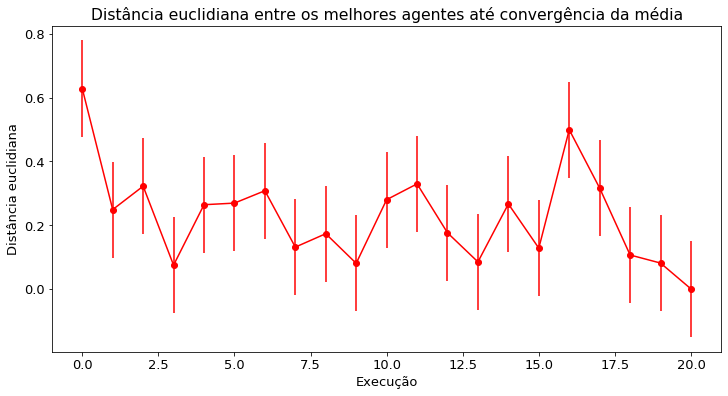

In [79]:
from scipy.spatial import distance
distancias_euclidianas = []
cont = 0
for i in df_media_desvpad_fa_rand['solucoes']:
    if cont < len(df_media_desvpad_fa_rand['solucoes']) - 1:
        proximo = df_media_desvpad_fa_rand['solucoes'][cont+1]
        primeiro_ponto = (i[0], i[1])
        segundo_ponto = (proximo[0], proximo[1])
        distancias_euclidianas.append(distance.euclidean(primeiro_ponto, segundo_ponto))
        cont = cont+1
    else:
        distancias_euclidianas.append(0)
df_media_desvpad_fa_rand['distancias_euclidianas'] = distancias_euclidianas
fig = plt.figure(figsize=(12,6))
plt.title('Distância euclidiana entre os melhores agentes até convergência da média')
plt.rcParams.update({'font.size': 13})
plt.xlabel('Execução')
plt.ylabel('Distância euclidiana')
df_media_desvpad_fa_rand['distancias_euclidianas'] = np.clip(df_media_desvpad_fa_rand['distancias_euclidianas'],0, 1)
df_media_desvpad_fa_rand['distancias_euclidianas'].plot(yerr=df_media_desvpad_fa_rand['distancias_euclidianas'].std(), marker = 'o', color='red')
plt.savefig('distancia_euclidiana_pso_bigml.png')

print(df_media_desvpad_fa_rand['distancias_euclidianas'].std())

### Gráfico das AUCs em cada execução do PSO até sua convergência

0.898374143084895


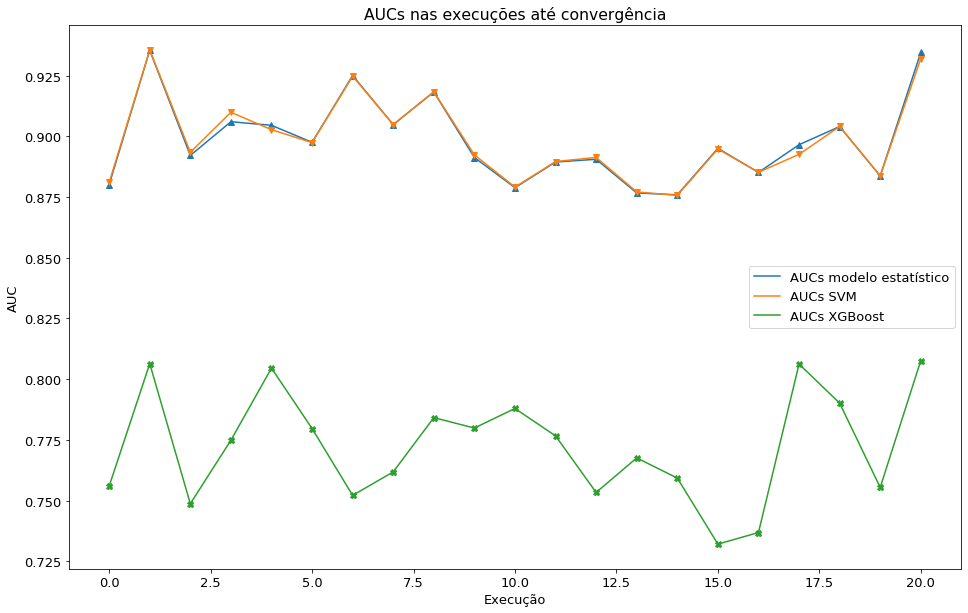

In [80]:
import matplotlib as mpl

# create valid markers from mpl.markers
valid_markers = ([item[0] for item in mpl.markers.MarkerStyle.markers.items() if
item[1] is not 'nothing' and not item[1].startswith('tick') and not item[1].startswith('caret')])
df_media_desvpad_fa_rand.rename(columns = {'aucs':'AUCs modelo estatístico', 'auc_svm':'AUCs SVM', 'auc_xgboost' : 'AUCs XGBoost'}, inplace = True) 

print(df_media_desvpad_fa_rand['AUCs modelo estatístico'].mean())
ax = df_media_desvpad_fa_rand[['AUCs modelo estatístico', 'AUCs SVM', 'AUCs XGBoost']].plot(figsize=(16,10))


# valid_markers = mpl.markers.MarkerStyle.filled_markers
markers = np.random.choice(valid_markers, df_media_desvpad_fa_rand.shape[1], replace=False)
for i, line in enumerate(ax.get_lines()):
    line.set_marker(markers[i])

plt.title('AUCs nas execuções até convergência')
plt.rcParams.update({'font.size': 18})
plt.xlabel('Execução')
plt.ylabel('AUC')


plt.savefig('auc_pso_bigml.png')


### Análise da avaliação de, os rótulos classificados pelo XGBoost, serem um subconjunto da classificação de rótulos do SVM

In [82]:
df_analise_subconjunto = pd.DataFrame(data = np.round(predictionsSVM)[:,1], columns = ['SVM'] )

In [83]:
df_analise_subconjunto['Target'] = y_test_svm.values

In [84]:
df_analise_subconjunto['XGBoost'] = np.round(predictionsXGBoost[:,1])

In [85]:
df_analise_subconjunto['Acertos_SVM'] = df_analise_subconjunto['SVM'][(df_analise_subconjunto['SVM'] == df_analise_subconjunto['Target'])].replace(to_replace = 0, value=1)

In [86]:
df_analise_subconjunto['Acertos_SVM'] = np.nan_to_num(df_analise_subconjunto['Acertos_SVM'])

In [87]:
df_analise_subconjunto['Acertos_SVM'].value_counts()

1.0    618
0.0     49
Name: Acertos_SVM, dtype: int64

In [88]:
df_analise_subconjunto['Acertos_XGBoost'] = df_analise_subconjunto['XGBoost'][(np.logical_and(df_analise_subconjunto['XGBoost'],1) & np.logical_and(df_analise_subconjunto['Target'],1))].replace(to_replace = 0, value=1)

In [89]:
df_analise_subconjunto['Acertos_XGBoost'] = np.nan_to_num(df_analise_subconjunto['Acertos_XGBoost'])

In [90]:
def converte(x):
    if x == True:
        return 1
    else:
        return 0

In [91]:
df_analise_subconjunto['Iguais_ambos'] = df_analise_subconjunto['Acertos_SVM'] == df_analise_subconjunto['Acertos_XGBoost']

In [92]:
df_analise_subconjunto['Acertos_SVM'].value_counts()

1.0    618
0.0     49
Name: Acertos_SVM, dtype: int64

In [93]:
df_analise_subconjunto['Acertos_XGBoost'].value_counts()

1.0    547
0.0    120
Name: Acertos_XGBoost, dtype: int64

In [106]:
df_analise_subconjunto['Iguais_ambos'] = df_analise_subconjunto['Iguais_ambos'].apply(converte)

In [107]:
df_analise_subconjunto['Iguais_ambos'] = df_analise_subconjunto[df_analise_subconjunto['Iguais_ambos'] == df_analise_subconjunto['Target']]

In [108]:
df_analise_subconjunto['Iguais_ambos'].value_counts()

1.0    540
0.0     64
Name: Iguais_ambos, dtype: int64

In [100]:
df_analise_subconjunto['Acertos_SVM'].value_counts()

1.0    618
0.0     49
Name: Acertos_SVM, dtype: int64

In [101]:
df_analise_subconjunto['Acertos_XGBoost'].value_counts()

1.0    547
0.0    120
Name: Acertos_XGBoost, dtype: int64

## Gráfico dos valores de Alpha e Beta para o ponderamento do modelo estatístico bayesiano com o PSO

In [102]:
 df_media_desvpad_PSO_rand['solucao_x'] = np.clip(df_media_desvpad_PSO_rand['solucao_x'], 0, 1)

In [103]:
 df_media_desvpad_PSO_rand['solucao_y'] = np.clip(df_media_desvpad_PSO_rand['solucao_y'], 0, 1)

In [116]:
df_media_desvpad_PSO_rand

,tempo,solucoes,rand_values,AUCs modelo estatístico,AUCs SVM,AUCs XGBoost,solucao_x,solucao_y,distancias_euclidianas
0,1.415308,"[1.1054511797514492, -0.05279041345276427]",691,0.880062,0.881012,0.755927,1.000000,0.000000,0.628441
1,1.440792,"[0.4964008063094494, 0.10211434503015131]",687,0.935446,0.935606,0.806377,0.496401,0.102114,0.248755
2,1.481317,"[0.7424614957963522, 0.06560327479151047]",482,0.892134,0.893439,0.748695,0.742461,0.065603,0.322126
3,1.563118,"[0.4265704290356883, 0.12867586323757435]",545,0.906026,0.909913,0.774830,0.426570,0.128676,0.074588
4,1.520755,"[0.3534888960220427, 0.11376124506526177]",74,0.904550,0.902751,0.804533,0.353489,0.113761,0.264051
5,1.544780,"[0.6132669365872206, 0.06645284669438647]",983,0.897552,0.897424,0.779665,0.613267,0.066453,0.269101
6,1.666887,"[0.8730416425526615, -0.0037766974727486084]",976,0.925064,0.924770,0.752116,0.873042,0.000000,0.307928
7,1.652766,"[0.565126113866149, -0.0010091090716097318]",475,0.904838,0.904854,0.761812,0.565126,0.000000,0.131079
8,1.603325,"[0.6962050007556456, -0.001071871614529236]",867,0.918293,0.918356,0.784144,0.696205,0.000000,0.173166
9,1.747612,"[0.8582769947594492, 0.05991308977116076]",886,0.891288,0.892364,0.779868,0.858277,0.059913,0.080260


In [118]:
df_media_desvpad_PSO_rand['solucao_x'].rename('alpha', inplace=True)
df_media_desvpad_PSO_rand['solucao_y'].rename('beta', inplace=True)

df_media_desvpad_PSO_rand.rename(columns={'solucao_x':'alpha',
                          'solucao_y':'beta'}, inplace=True)


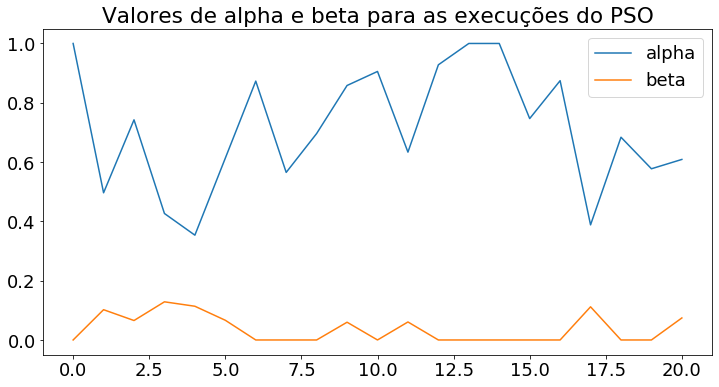

In [125]:
df_media_desvpad_PSO_rand[['alpha', 'beta']].plot(figsize=(12,6))
plt.title("Valores de alpha e beta para as execuções do PSO")
plt.savefig('alpha_beta_pso.png')

In [122]:
df_media_desvpad_PSO_rand['alpha'].mean()

0.7129239424039858

In [123]:
df_media_desvpad_PSO_rand['beta'].mean()

0.03730628252717125

# Análise Parâmetros XGBoost

In [64]:
from sklearn import metrics 
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

X_train_svm, X_test_svm, y_train_svm, y_test_svm = aplicaKFoldRand(x_pca_svm, df_bigml_target, np.random.randint(0,10000))
X_train_xgboost, X_test_xgboost, y_train_xgboost, y_test_xgboost = aplicaKFoldRand(x_pca_xgboost, df_bigml_target, np.random.randint(0,10000))
#gb1 = XGBClassifier(learning_rate =0.1, n_estimators=1000, max_depth=5, min_child_weight=1, gamma=0, subsample=0.8,
#                       colsample_bytree=0.8, objective= 'binary:logistic', nthread=4)
 
gb1 = XGBClassifier(objective= 'binary:logistic', nthread=4)
 
grid_values = {'n_estimators': np.arange(1, 200, 20),'colsample_bytree':np.arange(0.5, 1.1, 0.1), 'max_depth': np.arange(3, 20), 'learning_rate': np.arange(0.01, 0.21, 0.01)}
grid_gb1_acc = GridSearchCV(gb1, param_grid = grid_values,scoring = 'roc_auc', verbose = 2)
grid_gb1_acc.fit(X_train_xgboost, y_train_xgboost)

#Predict values based on new parameters
y_pred_acc = grid_gb1_acc.predict_proba(X_test_xgboost)

fpr, tpr, thresholds = roc_curve(y_test_xgboost, y_pred_acc[:,1])
roc_auc = auc(fpr, tpr)



# New Model Evaluation metrics 
print('AUC Score : ' + str(roc_auc))
print(grid_gb1_acc.best_params_)




Fitting 5 folds for each of 23800 candidates, totalling 119000 fits
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=21 
[CV]  colsample_bytr

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s remaining:    0.0s



[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=3, n_estimators=61,

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=4, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=5, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=6, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=7, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_d

[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=15, n_est

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.01, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=3, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=4, n_e

[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=5, n_estimators=41, 

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=6, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=7, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=13, n_estimators=41, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=13, n_estimators=41, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=13, n_estimators=41, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=3, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=4, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=5, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=6, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=7, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_d

[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=15, n_est

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.03, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=3, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=4, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=5, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=6, n_e

[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=7, n_estimators=41, 

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=17, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.04, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.04, max_d

[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=3, n_estimators=61, 

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=4, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=5, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=6, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=7, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.05, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=3, n_estimators

[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21, total=   0.

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=5, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=5, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=6, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=7, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=8, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=9, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=9, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimato

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=12

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=13, n_

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=17, n_

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=18, n_

[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=41,

[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.060000000000000005, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=3, n_estimator

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=4, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101 


[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=9, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=10, n_esti

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=11, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=12, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1 

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=13, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=14, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=15, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=15, n_estimato

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=16, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=17, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimator

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=18, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=19, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.06999999999999999, max_depth=19, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=3, n_estimators=121, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=5, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=5, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=6, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=7, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=7,

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=8, n

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=9, n

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=3, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=5, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=6, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=7, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=3, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=7, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=9, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=10, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=10, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1 
[CV

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=11, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=12, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=13, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=13, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=13, n_estima

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=14, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimator

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=16, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=17, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=18, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.09999999999999999, max_depth=19, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=3, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=4, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=5, n_e

[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=6, n_estimators=41, 

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=7, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=12, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.11, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=3, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=4, n_e

[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=5, n_estimators=41, 

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=6, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=7, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=11, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=3, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=4, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=5, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=6, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=7, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_d

[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=15, n_est

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.13, max_d

[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=3, n_estimators=61, 

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=4, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=6, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=7, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV] 

[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=7, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=7, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=9, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=9, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=10, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=1 

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=11, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=12, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=13, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=13, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=13, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=13, n_estimato

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=14, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=15, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimator

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=16, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=17, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=18, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.15000000000000002, max_depth=19, n_estimators

[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=3, n_estimators=61, 

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=4, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=5, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=6, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=7, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.16, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=3, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=4, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=5, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=6, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=7, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=8, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=9, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=10, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[C

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=10, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=11, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=12, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=12, n_estima

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=13, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1 

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=15, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=16, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=17, n_estimato

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=18, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators

[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.18000000000000002, max_depth=19, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=1

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=6, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=7, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=7, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=7, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=8, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=8, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=8, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=8, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=8, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=8, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=9, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=10, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=10, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=10, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=11, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=11, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=12, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=12, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=12, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=13, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=13, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=14, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=15, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=15, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=15, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.1

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=18, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=18, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=18, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=18, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=18, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=18, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.5, learning_rate=0.19, m

[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=19, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=19, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=19, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=19, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=19, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.19, max_depth=19, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.19, max

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=4, n_estimators=10

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=5, n_estimators=10

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=6, n_estimators=81

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=7, n_estimators=81

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=8, n_estimators=81

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=9, n_estimators=81

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=10, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=11, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=13, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=14, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=15, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=16, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=17, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=18, n_e

[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.5, learning_rate=0.2, max_depth=19, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=3, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=6, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=9, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.01, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=3, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=4, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=6, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=9, n_e

[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=10, n_est

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=3, n_e

[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=4, n_estimators=41, 

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=6, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=9, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.03, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=3, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=6, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=9, n_e

[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=10, n_est

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.04, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=3, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=4, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=6, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=9, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.05, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=3, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=4, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=4, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=6, n_estima

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=7, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=8, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=1 

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=9, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=11, 

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=12, n_

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=13, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=15, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=16, n_

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=17, n_

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=18, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n

[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.060000000000000005, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=3, n_estimators=121, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=4, n_estimators=101 


[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61 
[CV] 

[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41, total=   0.1s
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=8, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=8, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=8, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=9, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=10, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=11, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=12, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=1 

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=13, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=14, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=15, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=15, n_estimato

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=16, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=17, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimator

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=141, total=   1.5s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=141, total=   1.5s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=18, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=19, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.06999999999999999, max_depth=19, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=3, n_estimators=121, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_de

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=5, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_de

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_de

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_dept

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=9, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=9, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=9,

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=3, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=4, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=6, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=9, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_d

[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=15, n_est

[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=16, n_est

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=9, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=10, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=11, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimator

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=12, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=13, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=14, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=14, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=14, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=15, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=16, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=1 

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=17, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=18, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=19, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.09999999999999999, max_depth=19, n_estimato

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=3, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=4, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=6, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=9, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=10, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.11, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=3, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=4, n_e

[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=5, n_estimators=41, 

[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=6, n_estimators=41, 

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=9, n_e

[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=10, n_est

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=3, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=4, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=6, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=9, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=3, n_e

[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=4, n_estimators=61, 

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=6, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=9, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=3, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=6, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=1 
[C

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=10, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=11, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=12, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=12, n_estimato

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=13, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=14, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimator

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=15, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=16, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=17, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=18, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=1

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=8, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=8, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=8, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=8, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=9, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=10, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=10, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=10, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=10, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=13, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=13, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=14, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=15, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=15, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=15, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.1

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=18, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=18, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, m

[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=19, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=19, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=19, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.16, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=3, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=4, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=6, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=9, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=3, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=4, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=10, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimator

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=11, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=12, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=13, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=13, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=14, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=15, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimator

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=16, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=17, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=17, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=17, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=17, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=17, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=18, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=18, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=18, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=18, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=18, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=18, n_estimators

[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.18000000000000002, max_depth=19, n_estimators

[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=3, n_estimators=61, 

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=4, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=5, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=6, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=7, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=8, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=9, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.19, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=3, n_estimators=61

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=4, n_estimators=61

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=5, n_estimators=61

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=6, n_estimators=61

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=7, n_estimators=61

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=8, n_estimators=61

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=9, n_estimators=61

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=10, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=11, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=12, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=13, n_e

[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=14, n_estimators=41, 

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=15, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=16, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=17, n_e

[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.6, learning_rate=0.2, max_depth=18, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=3, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=4, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=5, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=6, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=7, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=8, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=9, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.01, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.01, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=3, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=4, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=5, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=6, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=7, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=8, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=9, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.02, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=3, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=4, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=5, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=6, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=7, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=8, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=9, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_d

[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=12, n_est

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.03, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.03, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=3, n_e

[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=4, n_estimators=41, 

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=5, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=6, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=7, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=8, n_e

[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=9, n_estimators=41, 

[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=10, n_est

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.04, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.04, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=3, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=5, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=6, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=7, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=8, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=9, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_d

[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=14, n_est

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=15, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.05, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.05, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=3, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=4, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1 
[CV

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=5, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=6, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=7, n_estima

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=8, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estima

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=12, 

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=13, n_

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_dep

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=17, n_

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=18, n_

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_

[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.060000000000000005, max_depth=19, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimator

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=4, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=5, n_estimators=1

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=6, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=1 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=10, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=11, n_estimato

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=12, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimator

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=14, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=15, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=15, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=16, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=17, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimator

[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.06999999999999999, max_depth=19, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=5, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=12, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08,

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.08, max

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.08, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=3, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=4, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=5, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=6, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=7, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=8, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=9, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_d

[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=18, n_est

[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=3, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=7, n_estimators=1

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=1 


[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=10, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=11, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=12, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=13, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimator

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=15, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=16, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=17, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.09999999999999999, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=1

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=11, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=12, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=12, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=12, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=13, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=13, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=14, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=15, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=15, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=15, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.1

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=18, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=18, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.11, m

[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.11, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.11, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=3, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=4, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=5, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=6, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=7, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=8, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=9, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.12, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=3, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=4, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=5, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=6, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=7, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=8, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=9, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.13, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=3, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=4, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=5, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=6, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=7, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=8, n_e

[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=9, n_estimators=41, 

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.14, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=5, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=7, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=8, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=10, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=11, n_estima

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=12, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=13, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimator

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=14, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=15, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=15, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=16, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=17, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimator

[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.15000000000000002, max_depth=19, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=6, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=7, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=8, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=8, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=10, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16,

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=13, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=14, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_d

[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=15, n_est

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=16, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.16, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.16, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=3, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=4, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=5, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=6, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=7, n_e

[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=8, n_estimators=41, 

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=9, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.17, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=3, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=4, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=7, n_estimators=1

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[C

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=10, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=11, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=11, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=12, n_estimato

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=13, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimator

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=15, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=16, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=17, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators

[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.18000000000000002, max_depth=19, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytre

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=4, 

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=8, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=8, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=8, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=8, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=9, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_d

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=10, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=10, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=11, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=12, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=13, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=13, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=13, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=14, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=15, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=15, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=18, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=18, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=18, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=18, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19,

[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=19, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=19, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.19, max_depth=19, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.19, max

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=4, n_estimators=10

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=5, n_estimators=10

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=6, n_estimators=10

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=7, n_estimators=81

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=8, n_estimators=81

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=9, n_estimators=81

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=10, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=12, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=13, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=14, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=15, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=16, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=17, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=18, n_e

[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7, learning_rate=0.2, max_depth=19, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=3, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=7, n_estimators=1

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1 
[C

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=10, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=11, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=12, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=12, n_estimato

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=13, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=15, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=16, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=16, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=16, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=17, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.01, max_depth=19, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=1 


[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=4, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=5, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=5, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=5, n_estimators=101

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=6, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=7, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=9, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=9, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=10, n_esti

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=11, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=12, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=13, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=14, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=14, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=14, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=15, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=16, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=17, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=18, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=19, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=19, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=19, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.02, max_depth=19, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=3, n_estimators=101 
[CV]

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=4, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=8, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=8, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=8, n_estimators=101, total=   1.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=9, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=9, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=9, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=10, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=11, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=12, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=13, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=13, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=13, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=13, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=13, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=14, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=14, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=15, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=16, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=17, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=18, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=18, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=18, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=18, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=18, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=18, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.03, max_depth=19, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=3, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=7, n_estimators=81, total=   1.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=7, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=7, n_estimators=1

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=1 
[C

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=10, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=11, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=12, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=12, n_estimato

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=13, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=14, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=15, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=16, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=17, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.04, max_depth=19, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=3, n_estimators=1 


[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=5, n_estimators=101 


[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=6, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=10, n_esti

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=11, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=12, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=13, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=14, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=14, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=15, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=16, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=17, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=18, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=19, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.05, max_depth=19, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06000000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=4, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=9, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=9, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=11, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=12, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=13, n_estimato

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=16, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=17, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.08, max_depth=19, n_estimators

[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1 
[CV]

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=10, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=11, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=12, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=12, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=12, n_estima

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=13, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=161, total=   1.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_estimators=161, total=   1.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=15, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=16, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=17, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09, max_depth=19, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_d

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.0999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=5, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=8, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=8, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=9, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=9, n_estimators=1

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=10, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=10, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=11, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=12, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=13, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=15, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=16, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=17, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=18, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=18, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=18, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.11, max_depth=19, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=3, n_estimators=61 
[CV] 

[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=11, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=12, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=12, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=13, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=15, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=16, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=17, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=18, n_estimators

[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.12, max_depth=19, n_estimators=61, total=   

[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=11, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=12, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=13, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=16, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=17, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.13, max_depth=19, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=6, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=10, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=1 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=11, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=12, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=13, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=13, n_estimato

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=16, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=17, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=17, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=17, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.14, max_depth=19, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=3, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=9, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=9, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=10, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=11, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=12, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=13, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=14, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=14, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=15, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=17, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=18, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=18, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=18, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=18, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=18, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.16, max_depth=19, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=3, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=10, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=11, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=12, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=13, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=14, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=16, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=17, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=17, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.17, max_depth=19, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.1800000000000000

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=5, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=7, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=7, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=8, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=10, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=10, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=11, n_estima

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=12, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=13, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=14, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=15, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=15, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=16, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=16, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=16, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=16, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=17, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimator

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.19, max_depth=19, n_e

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=3, n_estimators=141 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=4, n_estimators=101 
[CV]  co

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=5, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41 
[CV]  colsample

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=6, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=7, n_estimators=181 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=8, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=8, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=8, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=8, n_estimators=141 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=9, n_estimators=121 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=10, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=10, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=11, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=11, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=12, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=13, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=13, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=13, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=13, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=14, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=15, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=16, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=16, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=17, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=18, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=18, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=18, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=18, n_estimators=

[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=19, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=19, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=19, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=19, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=19, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.7999999999999999, learning_rate=0.2, max_depth=19, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=3, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=3, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=4, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=9, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=9, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=10, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=11, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=12, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=13, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=13, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=13, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=13, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=13, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=14, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=14, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=14, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=14, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=15, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=16, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=17, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=18, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=18, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=18, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=18, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=18, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=18, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=19, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.01, max_depth=19, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=3, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=6, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=6, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=1 


[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=10, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=11, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=12, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=13, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=14, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=15, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=16, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=16, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=16, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=17, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=18, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.02, max_depth=19, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=1 


[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=4, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=5, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=5, n_estimators=101

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=6, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=9, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=10, n_esti

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=11, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=12, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=13, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=14, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=14, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=15, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=16, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=18, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=19, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=19, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=19, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.03, max_depth=19, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=3, n_estimators=101 
[CV]

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=4, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=7, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=9, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=9, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=10, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=1 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=11, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=12, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=12, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=13, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=13, n_estimato

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=14, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=16, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=17, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=17, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=17, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=18, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.04, max_depth=19, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=7, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=10, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=10, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=10, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=11, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=11, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=11, n_estima

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=12, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=14, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=15, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=15, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=15, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=16, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=17, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=18, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.05, max_depth=19, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.0699999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=4, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=161, total=   1.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=7, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=7, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=8, n_estimators=1

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=9, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=11, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=12, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=13, n_estimato

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=14, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=16, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=17, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=18, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.08, max_depth=19, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=10, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=11, n_estimato

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=12, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=13, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=14, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=15, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=15, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=16, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=17, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=18, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09, max_depth=19, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=7, n_estimators=1

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=1 


[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=10, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=11, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=12, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=13, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estim

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=15, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=16, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=17, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=18, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.11, max_depth=19, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=1 


[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=4, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=4, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=10, n_esti

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=11, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=12, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=13, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=14, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=14, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=15, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=16, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=17, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=18, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=19, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.12, max_depth=19, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=3, n_estimators=101, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=3, n_estimators=101 
[C

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=4, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=8, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=8, n_estimators=1

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=9, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=1 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=11, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=12, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=13, n_estimato

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=14, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=16, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=17, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=18, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.13, max_depth=19, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=5, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=6, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=7, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=7, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=8, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1 


[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=10, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=11, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=12, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=13, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=15, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=16, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=17, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=18, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_de

[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_dep

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.150000000

[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002,

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.1500000000000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=3, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=5, n_estimators=101 
[CV]

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=9, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=9, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=10, n_esti

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=11, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=12, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=13, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=14, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=14, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=14, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=14, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=15, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=16, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=16, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=17, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=18, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=19, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.16, max_depth=19, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=3, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=3, n_estimators=101 
[C

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=4, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=8, n_estimators=1

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=9, n_estimators=81 
[CV] 

[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=41, total=   

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=10, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=1 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=11, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=12, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=12, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=13, n_estimato

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=14, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=16, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=17, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=17, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=18, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.17, max_depth=19, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.1800000000000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=6, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=6, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1 
[C

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=10, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=11, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=12, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=12, n_estimato

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=13, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=13, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=14, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimator

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=15, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=16, n_e

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=17, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=18, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=18, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=1 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=4, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=4, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=4, n_estimators=141 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101 
[CV]  

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=41 
[CV]  colsample

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=8, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1 
[CV]  colsample_byt

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=9, n_estimators=181 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=10, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=10, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=10, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=11, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=11, n_estimators=1

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=12, n_estimators=81 
[CV] 

[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=41, total=   0.2s
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=13, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=14, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=15, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=15, n_estimators=

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=16, n_estimators=1

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=17, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=18, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=1 
[CV] 

[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.8999999999999999, learning_rate=0.2, max_depth=19, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=3, n_estimators=121, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=3, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=5, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=6, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=7, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=9, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=9, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=9, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=9, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=9, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=10, n_esti

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=11, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=13, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=14, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=14, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=14, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=14, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=14, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=15, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=15, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=16, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=181, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=17, n_estimators=181, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=18, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=19, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=19, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=19, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=19, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=19, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.01, max_depth=19, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=3, n_estimators=101 
[CV]

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=4, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=5, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=7, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=7, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=7, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=8, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=8, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=8, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=8, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=9, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=10, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=11, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=12, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=12, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=13, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=13, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=13, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=13, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=13, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=13, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=14, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=14, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=14, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=181, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=181, total=   1.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=181, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=15, n_estimators=181, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estim

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estimators=141, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=16, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=17, n_estimators=101, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=17, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=17, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=17, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=17, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=17, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=18, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=18, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=18, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=18, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=18, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=18, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.02, max_depth=19, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=3, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=5, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=5, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=5, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=6, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=6, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=6, n_estimators=1

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=7, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=8, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=1 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=10, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=10, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=10, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=10, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=10, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=10, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=11, n_estimators=81, total=   1.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=11, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=11, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=11, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=11, n_estimato

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=12, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=13, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estim

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=14, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=15, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=15, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=15, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=15, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=15, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=15, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=16, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=17, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=17, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=18, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.03, max_depth=19, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=3, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=4, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=4, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=4, n_estimators=101 
[C

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=5, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=5, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=6, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=8, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=8, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=8, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=9, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=9, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=9, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=9, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=9, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=9, n_estimators=1

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=10, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=10, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=10, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=10, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=10, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=11, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=12, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=13, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=13, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=13, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=13, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=13, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=14, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=14, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=14, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=14, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=14, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=14, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=15, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=16, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=17, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=18, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=18, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=18, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=18, n_estimators=121, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=18, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=18, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=19, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=19, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=19, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.04, max_depth=19, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=3, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=6, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=6, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=7, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=7, n_estimators=1

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=8, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=8, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=8, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=9, n_estimators=181, total=   1.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=1 


[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=10, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=11, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=11, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=12, n_estimators=81, total=   1.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=12, n_estimators=81, total=   1.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=12, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=12, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=13, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=181, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=14, n_estimators=181, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=15, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=16, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=16, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=16, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=16, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=16, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=16, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=17, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=18, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=181, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=181, total=   1.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.05, max_depth=19, n_estimators=181, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_ra

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06000000000000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=101, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=101, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=181, total=   1.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=181, total=   1.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06000000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=141, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=141, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.0

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=101, total=   1.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=121, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=101, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=121, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   1.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=61, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.0699999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   1.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=161, total=   1.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181, total=   1.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=3, n_estimators=81 
[CV] 

[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=4, n_estimators=41, total=   0.1s
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=6, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=6, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=6, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=6, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=6, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=7, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=8, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=8, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=8, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=8, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=8, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=9, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=10, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=11, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=12, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=12, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=13, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=13, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=14, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=14, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=14, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   1.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=16, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=17, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=17, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=17, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=18, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=19, n_estimators=61, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.08, max_depth=19, n_estimators

[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=3, n_estimators=41, total=   0.1s
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=3, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=5, n_estimators=121, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=5, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=6, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=7, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=7, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=7, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=7, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=7, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=7, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=8, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=8, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=8, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=10, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=10, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=10, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=10, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=11, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=11, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=11, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=11, n_esti

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=12, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=12, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=13, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=14, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=15, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=15, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=15, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=16, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=17, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=17, n_estimators=61, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=17, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=181, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=18, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09, max_depth=19, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5,

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_d

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=101, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=101, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=121, total=   2.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.0999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=3, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=4, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=5, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=1 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=7, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=7, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=7, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=7, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=7, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=8, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=8, n_estimators=81, total=   1.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=8, n_estimators=101, total=   1.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=8, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=8, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=8, n_estimators=101

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=9, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=9, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=10, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estim

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=11, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=12, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=12, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=12, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=13, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=13, n_estimators=81, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=13, n_estimators=81, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=13, n_estimators=81, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=13, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=14, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=14, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=14, n_estimators=41, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=14, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=14, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=15, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=16, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=17, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=17, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=17, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=17, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=17, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=18, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=18, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=18, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=18, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=19, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=19, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=19, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=19, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=19, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.11, max_depth=19, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=3, n_estimators=41 
[CV] 

[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=4, n_estimators=41, total=   0.1s
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=7, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=7, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=8, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=10, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=11, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=12, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=12, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=13, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=13, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=14, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=14, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=15, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=16, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=17, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=17, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=17, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=18, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=18, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.12, max_depth=19, n_estimators

[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=3, n_estimators=41, total=   0.1s
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=4, n_estimators=181, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=1 
[CV]  colsamp

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=6, n_estimators=121, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=6, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=6, n_estimators=

[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=8, n_estimators=81, total=   0.3s
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=1 
[C

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=10, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=11, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=12, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=12, n_estimato

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=13, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=14, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estim

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=15, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=16, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=16, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=17, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=18, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=181, total=   1.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=181, total=   2.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=181, total=   1.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.13, max_depth=19, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimato

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=161, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=5, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=5, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=5, n_estimators=101

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=6, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=6, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=7, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=1 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=9, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=9, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=9, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=9, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=9, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=10, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=10, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=10, n_estima

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=11, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=11, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=12, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=13, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=14, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=14, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=14, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=14, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=15, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=16, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=16, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=18, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=19, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=19, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.14, max_depth=19, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=61, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7,

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141, total=   1.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_d

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.1500000000000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=161, total=   1.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.15000000000000002

[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=3, n_estimators=41, total=   0.1s
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=6, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=6, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=6, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=7, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=7, n_estimators=1

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=8, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=8, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=8, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=181, total=   1.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=9, n_estimators=181, total=   1.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=1 


[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=10, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=11, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=11, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=12, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=12, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=13, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=13, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=15, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=16, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=16, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=16, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=16, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=17, n_estimators=81, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=17, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=17, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=18, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=21, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=181, total=   1.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=181, total=   1.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.16, max_depth=19, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimato

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=141, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=3, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=4, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=5, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=5, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=5, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=5, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=5, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=5, n_estimators=101 


[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=6, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=6, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=6, n_estimators=61 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=7, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=1 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=8, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=9, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=9, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=9, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=10, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=10, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=10, n_estima

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=11, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=11, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=11, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=12, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=13, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=14, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=14, n_estimators=121, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=14, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=14, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=14, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=15, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=15, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=15, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=15, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=16, n_estimators=61, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=16, n_estimators

[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=41, total=   

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=17, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=18, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=19, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=19, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=19, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=19, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.17, max_depth=19, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=61, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=81, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=101, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=161, total=   1.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_d

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.1800000000000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121, total=   1.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=101, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=81, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.1800000000000000

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=3, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=3, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=4, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=5, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=6, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=6, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=6, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=6, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=7, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=7, n_estimators=1

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=10, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=11, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=11, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=11, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=12, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=12, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=13, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=14, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimator

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_estimators=161, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=15, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=16, n_e

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=17, n_estimators=81, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=17, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=18, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=18, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=18, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=1 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=3, n_estimators=161 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=4, n_estimators=121, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=4, n_estimators=141, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=4, n_estimators=141 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=5, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=5, n_estimators=101 
[CV]  co

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=6, n_estimators=81 
[CV]  colsample

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=7, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=7, n_estimators=41 
[CV]  colsample

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=41 
[CV]  colsample

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=8, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=1 
[CV]  colsample_byt

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161, total=   0.9s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=9, n_estimators=181 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=10, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=10, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=10, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=10, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=10, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=11, n_estimators=81, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=11, n_estimators=1

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=12, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=12, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=21, total=   0.1s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=41, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=13, n_estimators=181, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=161, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=14, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=15, n_estimators=121, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=15, n_estimators=121, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=15, n_estimators=121, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=15, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=15, n_estimators=141, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=15, n_estimators=

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=16, n_estimators=81, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=16, n_estimators=101, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=16, n_estimators=1

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=17, n_estimators=61, total=   0.4s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=17, n_estimators=81 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=21, total=   0.2s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=41, total=   0.3s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=41 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=181, total=   0.8s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=18, n_estimators=181, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=1 
[CV] 

[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=141, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161, total=   0.5s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161, total=   0.6s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=161, total=   0.7s
[CV] colsample_bytree=0.9999999999999999, learning_rate=0.2, max_depth=19, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=21 
[CV]  colsam

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=4, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=41 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=7, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=8, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=8, n_estimators=41 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=9, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=1 
[CV]

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=11, n_estimators=1 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=11, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=11, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=1 

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=12, n_estimators=181,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=13, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=13, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=13, n_e

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=15, n_estimators=1, total= 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=16, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=16, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=16, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=16, n_esti

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=17, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=17, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=17, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=17, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=17, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=17, n_e

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=18, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=18, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=18, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=18, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=18, n_estimators=81, total=   

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=19, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=19, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=19, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=19, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.01, max_depth=19, n_estimators=61, total=   

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=3, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=3, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=3, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=3, n_estimators=101 


[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=4, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=4, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=4, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=4, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=4, n_estimators=161, total=   

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=5, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=5, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=5, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=1 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=7, n_estimators=1 
[

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=7, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=7, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=7, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=8, n_estimators=1 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=9, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=9, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=10, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=10, n_e

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=11, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=11, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=11, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=11, n_estimators=141,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=12, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=12, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=12, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=12, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=13, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=13, n_e

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=14, n_estimators=161,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=16, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=16, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=17, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=17, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=17, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=17, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=17, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.02, max_depth=19, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=3, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=3, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=5, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=5, n_estimators=41 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=21 
[CV]  

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=7, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=7, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=7, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=7, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=7, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=7, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=7, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=8, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=10, n_estimators=

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=11, n_estimators=101,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=12, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=12, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=12, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=12, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=12, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=12, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=13, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=13, n_e

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=14, n_estimators=181,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=16, n_estim

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=17, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimator

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.03, max_depth=19, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=3, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=3, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=3, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=4, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=4, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=4, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=4, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=4, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=4, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=4, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=5, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=5, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=5, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=5, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=5, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=5, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=5, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=6, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=7, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=7, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=7, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=7, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=8, n_estimators=101 
[C

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=9, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=9, n_estimators=61 
[CV] 

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=10, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=10, n_estimators=161,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=12, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estim

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=14, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=15, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=15, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=15, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=15, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=15, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=16, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=16, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=17, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=17, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=17, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=18, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=18, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=18, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=18, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=18, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.04, max_depth=19, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=4, n_estimators=1 
[

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsam

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=6, n_estimators=21 
[CV]  

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=7, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=7, n_estimators=101, total=   0.

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=8, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=8, n_estimators=101, total=   0.0s
[

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=9, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=9, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=9, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=9, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=9, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=9, n_estimators=101

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=10, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=10, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=10, n_esti

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=11, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=11, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=12, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=12, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=12, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=12, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=12, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=12, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=14, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=15, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=15, n_estimators=21

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=16, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=16, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=16, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=16, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=16, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=17, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=17, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=18, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=18, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=18, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=18, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=18, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=18, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=18, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.05, max_depth=19, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=10, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.0600000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.0

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=17, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.060000000000000005, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.060000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_de

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_dep

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=7, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_dep

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_de

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=11, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.069999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.069999999

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=14, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=15, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=17, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999, max_depth=19, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.06999999999999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=21 
[CV]  cols

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=3, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=5, n_estimators=1 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=21 
[CV]  colsampl

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=1 
[CV]  col

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=7, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=1 
[

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=8, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=9, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=9, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=9, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=9, n_estimators=

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=10, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=10, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=10, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=10, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=10, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=10, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=10, n_estimators=161,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=12, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=12, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=12, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=12, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=12, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=12, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=14, n_estim

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=15, n_estimators=1, tot

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=16, n_estimators=1, tot

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estim

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=17, n_estimators=181,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.08, max_depth=19, n_estimators=1 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=3, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=3, n_estimators=21 
[CV]  colsampl

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=4, n_estimators=21 
[CV]  colsampl

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=5, n_estimators=21 
[CV]  cols

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=21 
[CV]  

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=6, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=7, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=7, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=7, n_estimators=1 
[CV] 

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=8, n_estimators=141, total=   

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=21

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=11, n_estimators=1, tot

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=11, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=11, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=1 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=13, n_estimator

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=1, total=   0.0s
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=14, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=16, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=16, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=17, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=17, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=17, n_estimators=21 
[CV]

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=18, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=18, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=18, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=18, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=18, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=18, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=18, n_esti

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=19, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=19, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=19, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=19, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=19, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=19, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=19, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09, max_depth=19, n_estima

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=3, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=4, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_dep

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_de

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=8, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.099999999999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=13, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.099999999

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=15, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, m

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.09999999999999999, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.099999999

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=3, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=4, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=4, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=5, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=5, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=5, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=5, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=5, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=5, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=6, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=6, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=6, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=6, n_estimators=

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=7, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=7, n_estimators=121, total=   

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=8, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=8, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=9, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=9, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=9, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=9, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=9, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=9, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=9, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=9, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=10, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=11, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=11, n_es

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=12, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=12, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=13, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=13, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=13, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=15, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=15, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=16, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=16, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=16, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=16, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=16, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=16, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=18, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=18, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=18, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.11, max_depth=19, n_estimators=21 
[CV]

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=3, n_estimators=141, total=   

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=4, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=4, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=4, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=4, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=4, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=4, n_estimators=121, total=   

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=5, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=5, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=5, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=5, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=5, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=5, n_estimators=101 
[C

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=6, n_estimators=61 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=7, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=7, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=7, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=7, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=7, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=7, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=7, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=8, n_estimators=

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=10, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=10, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=10, n_estimators=61, total=   

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=11, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=11, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=12, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=12, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=12, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=13, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=13, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=13, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=13, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=14, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=16, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=16, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=16, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=16, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=21

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=19, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.12, max_depth=19, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=3, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=3, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=3, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=3, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=5, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=5, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=5, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=5, n_estimators=

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=7, n_estimators=41, total=   0.0s
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=8, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=8, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=8, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=8, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=8, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=9, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=9, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=10, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=10, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=12, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=12, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=13, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=13, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=13, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=13, n_estimators

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=21, total=   0.0s
[

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=1, total=   0.0s
[

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=1, total= 

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=16, n_estimators=181,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=17, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.13, max_depth=19, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=3, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=3, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=3, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=3, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=3, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=3, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=3, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=3, n_estimators=81 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=4, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=4, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=4, n_estimators=41 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=5, n_estimators=21 
[CV]  

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=6, n_estimators=61 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=7, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=7, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=7, n_estimators=81 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=8, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=8, n_estimators=81 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=21 
[CV]

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estim

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=11, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=12, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=12, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=12, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=12, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=12, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=12, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=12, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=12, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=13, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=13, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=13, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=13, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=13, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=13, n_e

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=14, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=14, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=14, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=14, n_estimators=161,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=16, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=16, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=17, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=17, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=17, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=17, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=17, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=17, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=17, n_estimators

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=18, n_estimators=21, total=   

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=21, total=   0.0s
[

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.14, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, ma

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=6, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=7, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_dep

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_de

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=10, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.1500000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.150000000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.150000000000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=14, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.150000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=18, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, m

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max_depth=19, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.15000000000000002, max

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=3, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=3, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=3, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=3, n_estimators=21 
[CV]  

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=4, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=4, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=5, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=5, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=5, n_estimators=101 
[C

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=6, n_estimators=61 
[CV] 

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=8, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=8, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=8, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=8, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=8, n_estimators=21, total=   0.0s
[CV] cols

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=9, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=9, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=9, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=9, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=9, n_estimators=41 
[CV] 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=10, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=10, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=10, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=10, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=11, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=11, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=11, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=11, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=11, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=11, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=12, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=12, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=12, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=13, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=13, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=13, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=13, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=13, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=13, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=13, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=14, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=14, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=14, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=14, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=14, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=14, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=14, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=21

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=15, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estim

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=16, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=17, n_e

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=18, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=18, n_estimators=181,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.16, max_depth=19, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=3, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=3, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=3, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=3, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=4, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=4, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=5, n_estimators=1 
[

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=6, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=6, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=6, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=7, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=7, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=8, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=8, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=9, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=9, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=9, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=9, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=9, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=9, n_estimators=101 
[C

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=10, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=10, n_estimato

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=11, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=11, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=11, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=11, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=11, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=11, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=11, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=11, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=12, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=12, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=12, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=13, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=13, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=13, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=13, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=13, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=14, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=14, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=14, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=14, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=14, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=14, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=14, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=15, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=15, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=15, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=16, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=16, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=16, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=16, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=16, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=17, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=17, n_estimators

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=1 
[CV

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=18, n_estimators=181,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=19, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.17, max_depth=19, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=3, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=4, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=5, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=7, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_de

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=9, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_de

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=10, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002,

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=11, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=12, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, m

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_d

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, 

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=14, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=15, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.180000000

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=16, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.1800000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=17, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.18000000000000002, max_depth=19, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.180000000

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=3, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=3, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=3, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=4, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=4, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=4, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=4, n_estimators=

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=5, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=5, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=5, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=5, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=5, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=5, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=5, n_estimators=121, total=   

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=6, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=6, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=6, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=7, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=7, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=7, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=7, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=7, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=7, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=7, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=8, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=8, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=8, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=8, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=8, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=8, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=9, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=10, n_estimators=1 


[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=10, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=11, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=11, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=11, n_estimators=1 
[CV

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=11, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=1 
[CV

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=12, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=13, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=13, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=13, n_estimator

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=13, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=13, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=14, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=14, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=14, n_estimator

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=15, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=15, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=15, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=15, n_e

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=16, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=16, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=16, n_estimators=121,

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=17, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=17, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=17, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=17, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=17, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=17, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=17, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=17, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=18, n_estimators=161 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=18, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=18, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=19, n_estimators=161, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=19, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.19, max_depth=19, n_e

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=3, n_estimators=181 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=3, n_estimators=181, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=4, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=4, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=4, n_estimators=1 
[CV]  colsample

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=5, n_estimators=1 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=5, n_estimators=1, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=5, n_estimators=21 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=5, n_estimators=21, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=5, n_estimators=21 
[CV]  colsample_by

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=6, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=6, n_estimators=61 
[CV]  colsample

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=7, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=7, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=7, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=7, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=7, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=7, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=7, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=7, n_estimators=81 
[CV]  colsample

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=8, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=8, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=8, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=8, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=8, n_estimators=101 
[CV]  colsam

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=9, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=9, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=9, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=9, n_estimators=101 
[CV]  co

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=10, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=10, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=10, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=11, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=11, n_estimators=

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=12, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=12, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=12, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=12, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=12, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=12, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=12, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=12, n_estimators=101

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=13, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=13, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=13, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=13, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=13, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=13, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=13, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=13, n_estimators=101 
[C

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=14, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=14, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=14, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=14, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=14, n_estimators=101 


[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=15, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=15, n_estimators=41 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=15, n_estimators=41, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=15, n_estimators=61 
[CV] 

[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=16, n_estimators=121 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=16, n_estimators=121, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=16, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=16, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=16, n_estimators=141, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=16, n_estimators=141 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=16, n_estimators=141, total=   

[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=18, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=18, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=18, n_estimators=61 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=18, n_estimators=61, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=18, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=18, n_estimators=81 
[CV]  colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=18, n_estimators=81, total=   0.0s
[CV] colsample_bytree=1.0999999999999999, learning_rate=0.2, max_depth=18, n_estimators=81 
[CV] 

[Parallel(n_jobs=1)]: Done 119000 out of 119000 | elapsed: 474.8min finished


AUC Score : 0.8913908482546572
{'colsample_bytree': 0.8999999999999999, 'learning_rate': 0.2, 'max_depth': 11, 'n_estimators': 61}


# Aplicação do XGBoost com parametrização atualizada junto ao modelo estatístico e PSO

In [33]:
def aplicaXGBoostOtimizado(X_train, X_test, y_train):
    xg_reg = xgb.XGBClassifier(objective ='binary:logistic', colsample_bytree = 0.9, learning_rate = 1,
                max_depth = 11, alpha = 10, n_estimators = 60)
    xg_reg.fit(X_train,y_train)
    predictionsXGBoost = xg_reg.predict_proba(X_test)
    return predictionsXGBoost

In [41]:
import SwarmPackagePy
import matplotlib.pyplot as plt
from SwarmPackagePy import testFunctions as tf
from sklearn.naive_bayes import GaussianNB

df_bigml, df_bigml_target = descarregaBaseDados()
scaler = StandardScaler()

scaler.fit(df_bigml)

tempo_rand = []
melhor_rand = []
rands = []
auc_fa = []
auc_svm = []
auc_xgboost = []
convergencia = False
media_aucs = 0
auc_anterior = 0
total_iguais = 0
i = 0
while(not convergencia):
    print(i)
    rand = np.random.randint(0, 1000)
    t1_start = perf_counter()  
    scaled_data = scaler.transform(df_bigml)  
    pca_svm = PCA(n_components = 16)
    pca_svm.fit(scaled_data)
    x_pca_svm = pca_svm.transform(scaled_data)

    pca_xgboost = PCA(n_components=17)
    pca_xgboost.fit(scaled_data)
    x_pca_xgboost = pca_xgboost.transform(scaled_data)
    rands.append(rand)
    X_train_svm, X_test_svm, y_train_svm, y_test_svm = aplicaKFoldRand(x_pca_svm, df_bigml_target, rand)
    X_train_xgboost, X_test_xgboost, y_train_xgboost, y_test_xgboost = aplicaKFoldRand(x_pca_xgboost, df_bigml_target, rand)
    
    predictionsSVM = aplicaSVM(X_train_svm, X_test_svm, y_train_svm)
    predictionsXGBoost = aplicaXGBoostOtimizado(X_train_xgboost, X_test_xgboost, y_train_xgboost)
    
    fprs, tprs, thresholdss = roc_curve(y_test_svm, predictionsSVM[:,1])
    fprx, tprx, thresholdsx = roc_curve(y_test_svm, predictionsXGBoost[:,1])
    
    auc_svm.append(auc(fprs, tprs))
    auc_xgboost.append(auc(fprx, tprx))
    
    vetor_pbest = []
    vetor_acertos = []
    
    alh = pso(40, retorna_acertos, 0, 1, 2, 50, y_test_svm, vetor_pbest, vetor_acertos)
    solucao = alh.get_Gbest()
    svm_alpha = ( ( 1 - predictionsSVM[:,1] ) ** solucao[0] )
    xgboost_beta =  ( ( 1 - predictionsXGBoost[:,1] ) ** solucao[1])
    predicoes = 1 - (svm_alpha*xgboost_beta)
    qtd_acertos = np.subtract(y_test_svm,np.round(predicoes))
    np.count_nonzero(qtd_acertos == 0)/len(y_test_svm) * 100
    fpr, tpr, thresholds = roc_curve(y_test_svm, predicoes)
    auc_fa.append(auc(fpr, tpr))
    
    media_aucs = round(sum(auc_fa)/len(auc_fa), 2)
    if media_aucs == auc_anterior:
        total_iguais = total_iguais + 1
    else:
        total_iguais = 0
    
    if total_iguais == 10:
        convergencia = True
    
    print('media_aucs:{}'.format(media_aucs))
    auc_anterior = media_aucs
    
    arr = np.array(alh.get_agents())
    t1_stop = perf_counter() 
    melhor_rand.append(alh.get_Gbest())
    tempo_rand.append(t1_stop-t1_start)
    
    print(alh.get_Gbest())

1    2850
0     483
Name: Churn, dtype: int64
0
[0.50307762 0.07072894]
media_aucs:0.91
[0.503077622770065, 0.0707289424504642]
0
[ 1.09180361 -0.02619759]
media_aucs:0.91
[1.0918036071549548, -0.026197586843419152]
0
[0.5162029  0.06113752]
media_aucs:0.91
[0.5162029003273703, 0.06113751556408733]
0
[0.38643098 0.12981163]
media_aucs:0.91
[0.3864309762529445, 0.12981163344953842]
0
[1.02831498 0.0975881 ]
media_aucs:0.91
[1.0283149797875009, 0.09758810044487136]
0
[0.58591944 0.24690776]
media_aucs:0.91
[0.5859194432729389, 0.24690776019998179]
0
[1.03592836 0.02209582]
media_aucs:0.9
[1.0359283563758515, 0.022095824979618706]
0
[0.51901656 0.09667092]
media_aucs:0.91
[0.5190165570718388, 0.09667091715662308]
0
[0.52449155 0.04189881]
media_aucs:0.91
[0.5244915512420217, 0.041898806714140986]
0
[0.58050513 0.53839434]
media_aucs:0.9
[0.5805051259456286, 0.5383943389891124]
0
[0.78789991 0.0292609 ]
media_aucs:0.9
[0.7878999102513524, 0.029260895582644973]
0
[ 5.91287805e-01 -4.2836900

In [42]:
df_media_desvpad_PSO_rand = pd.DataFrame()
df_media_desvpad_PSO_rand['tempo'] = tempo_rand
df_media_desvpad_PSO_rand['solucoes'] = melhor_rand
df_media_desvpad_PSO_rand['rand_values'] = rands
df_media_desvpad_PSO_rand['aucs'] = auc_fa
df_media_desvpad_PSO_rand['auc_svm'] = auc_svm
df_media_desvpad_PSO_rand['auc_xgboost'] = auc_xgboost
df_media_desvpad_PSO_rand[['solucao_x','solucao_y']] = pd.DataFrame(df_media_desvpad_PSO_rand.solucoes.values.tolist(), index= df_media_desvpad_PSO_rand.index)

### Gráfico das AUCs nas execuções 

0.019953763136184362


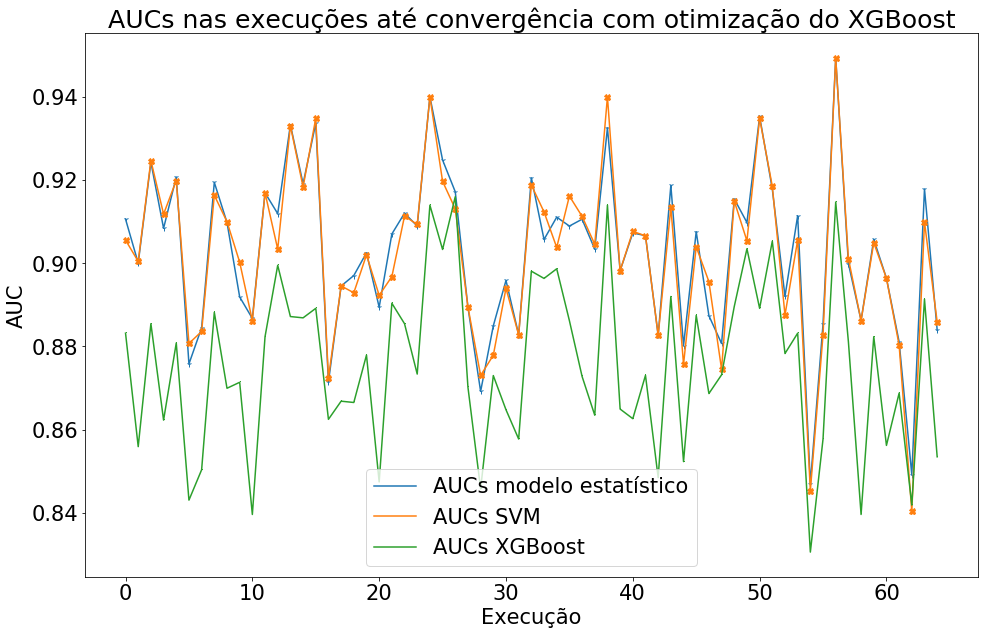

In [48]:
import matplotlib as mpl

# create valid markers from mpl.markers
valid_markers = ([item[0] for item in mpl.markers.MarkerStyle.markers.items() if
item[1] is not 'nothing' and not item[1].startswith('tick') and not item[1].startswith('caret')])
df_media_desvpad_PSO_rand.rename(columns = {'aucs':'AUCs modelo estatístico', 'auc_svm':'AUCs SVM', 'auc_xgboost' : 'AUCs XGBoost'}, inplace = True) 

print(df_media_desvpad_PSO_rand['AUCs modelo estatístico'].std())
ax = df_media_desvpad_PSO_rand[['AUCs modelo estatístico', 'AUCs SVM', 'AUCs XGBoost']].plot(figsize=(16,10))


# valid_markers = mpl.markers.MarkerStyle.filled_markers
markers = np.random.choice(valid_markers, df_media_desvpad_PSO_rand.shape[1], replace=False)
for i, line in enumerate(ax.get_lines()):
    line.set_marker(markers[i])

plt.title('AUCs nas execuções até convergência com otimização do XGBoost')
plt.rcParams.update({'font.size': 21})
plt.xlabel('Execução')
plt.ylabel('AUC')


plt.savefig('auc_pso_bigml_otimizacao_xgboost.png')


[0.69003388 0.04480128]


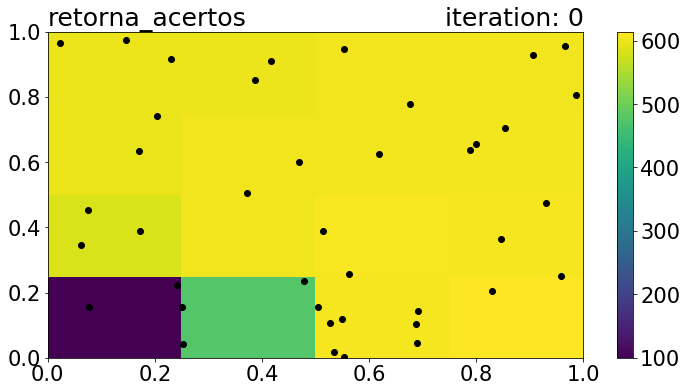

In [62]:
alh = pso(40, retorna_acertos, 0, 1, 2, 50, y_test_svm, vetor_pbest, vetor_acertos)
animationFA(alh.get_agents(), retorna_acertos, 0, 1, y_test_svm, sr=True)

In [66]:
sum(auc_xgboost)/len(auc_xgboost)

0.8755364948615643

In [68]:
df_media_desvpad_PSO_rand

,tempo,solucoes,rand_values,AUCs modelo estatístico,AUCs SVM,AUCs XGBoost,solucao_x,solucao_y
0,1.778357,"[0.503077622770065, 0.0707289424504642]",310,0.910597,0.905557,0.883186,0.503078,0.070729
1,1.619284,"[1.0918036071549548, -0.026197586843419152]",241,0.900024,0.900426,0.855933,1.091804,-0.026198
2,1.726385,"[0.5162029003273703, 0.06113751556408733]",832,0.924256,0.924657,0.885462,0.516203,0.061138
3,1.730225,"[0.3864309762529445, 0.12981163344953842]",498,0.908377,0.911793,0.862306,0.386431,0.129812
4,1.801157,"[1.0283149797875009, 0.09758810044487136]",570,0.920691,0.919861,0.880829,1.028315,0.097588
...,...,...,...,...,...,...,...,...
60,2.160577,"[0.7703575374575925, 0.013335887883456876]",261,0.896406,0.896388,0.856228,0.770358,0.013336
61,2.182637,"[0.4348453791761375, 0.10452021385003583]",233,0.881100,0.880309,0.868789,0.434845,0.104520
62,2.223061,"[0.42447666235284254, 0.15636278974885143]",710,0.849160,0.840415,0.841901,0.424477,0.156363
63,2.108356,"[0.5461110190371528, 0.1745546079887126]",545,0.917824,0.909891,0.891354,0.546111,0.174555
